# Dissertation Analysis - Part 3

# Clustering Analysis

In this analysis I am looking at spatial variation of clusters relating to spending and socioeconomic indicatrs. IMD is not comparable across the UK and therefore pre-scaled underlying indicators are utilised instead.

This is the sixth iteration of the analysis. In this iteration, spending is used instead of spending per head and GDP has been removed.

Note that the majority of data is read into the notebook from GitHub. Where this cannot be achieved, links to data and shapefiles have been provided.

To reduce the size & run time of the notebook, code has been hashed out which may be useful later. 

## Import Packages

In [1]:
#Importing packages

import numpy as np
import pandas as pd
import geopandas as gpd
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib as mpl
import re
import os

In [2]:
#Importing machine learning packages and formatting

import sklearn
from sklearn.neighbors import NearestNeighbors
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
from sklearn.preprocessing import PowerTransformer, RobustScaler, StandardScaler, MinMaxScaler
from sklearn.cluster import KMeans, DBSCAN, OPTICS
from esda.adbscan import ADBSCAN
%matplotlib inline

import random
random.seed(42)    # For reproducibility
np.random.seed(42) # For reproducibility

# Make numeric display a bit neater
pd.set_option('display.float_format', lambda x: '{:,.2f}'.format(x))

## Loading LSOA and DZ shapefiles

In [3]:
#Read in LSOA boundaries shapefile (local) downloadable from https://geoportal.statistics.gov.uk/datasets/lower-layer-super-output-areas-december-2011-boundaries-full-clipped-bfc-ew-v3?geometry=-23.080%2C50.522%2C18.734%2C55.161
lsoas = gpd.read_file(os.path.join('LSOA-boundaries','Lower_Layer_Super_Output_Areas__December_2011__Boundaries_Full_Clipped__BFC__EW_V3.shp'))
#checking projection
print(lsoas.crs)
#lsoas.plot()

epsg:27700


In [4]:
#Read in Scotland boundaries shapefile (local) downloadable from https://data.gov.uk/dataset/ab9f1f20-3b7f-4efa-9bd2-239acf63b540/data-zone-boundaries-2011
dzs = gpd.read_file(os.path.join('DataZone-boundaries-Scotland','SG_DataZone_Bdry_2011.shp'))
#checking projection
print(dzs.crs)
#dzs.plot()

epsg:27700


In [5]:
#wrangling shapefiles to consistent column names
dzs.rename(columns = {'DataZone':'Code'}, inplace = True)
lsoas.rename(columns = {'Shape__Are':'Shape_Area','LSOA11NM':'Name', 'LSOA11CD':'Code', }, inplace = True)
lsoas.drop(['OBJECTID','Shape__Len','LONG_','LAT', 'BNG_E', 'BNG_N'], axis = 1, inplace = True)
dzs.drop(['TotPop2011', 'ResPop2011', 'HHCnt2011', 'StdAreaHa', 'StdAreaKm2'], axis = 1, inplace = True)

#concatenating shapefiles

shps = [lsoas,dzs]

lsoas = pd.concat(shps)

#lsoas.plot()

In [6]:
lsoas.head()

,Code,Name,Shape_Leng,Shape_Area,geometry
0,E01000001,City of London 001A,"2,635.77","129,865.31","POLYGON ((532151.537 181867.433, 532152.500 18..."
1,E01000002,City of London 001B,"2,707.88","228,419.63","POLYGON ((532634.497 181926.016, 532632.048 18..."
2,E01000003,City of London 001C,"1,224.64","59,054.35","POLYGON ((532153.703 182165.155, 532158.250 18..."
3,E01000005,City of London 001E,"2,275.81","189,577.71","POLYGON ((533619.062 181402.364, 533639.868 18..."
4,E01000006,Barking and Dagenham 016A,"1,966.09","146,537.00","POLYGON ((545126.852 184310.838, 545145.213 18..."


## Importing all data

In [7]:
# Infrastructure
spending = pd.read_csv('ExportedData/Spendingtotal.csv', low_memory=False)
spending.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 41729 entries, 0 to 41728
Data columns (total 20 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   Unnamed: 0              41729 non-null  int64  
 1   Code                    41729 non-null  object 
 2   TotalPastValueSAB_Tr    41729 non-null  float64
 3   TotalFutureValueSAB_Tr  41729 non-null  float64
 4   PastValueSAB_GE         41729 non-null  float64
 5   FutureValueSAB_GE       41729 non-null  float64
 6   PastValueSAB_P          41729 non-null  float64
 7   FutureValueSAB_P        41729 non-null  float64
 8   PastValueSAB_S          41729 non-null  float64
 9   FutureValueSAB_S        41729 non-null  float64
 10  PastValueSAB_Un         41729 non-null  float64
 11  FutureValueSAB_Un       41729 non-null  float64
 12  PastValueSAB_LH         41729 non-null  float64
 13  FutureValueSAB_LH       41729 non-null  float64
 14  PastValueSAB_H          41729 non-null

In [8]:
# Populations
url = 'https://raw.githubusercontent.com/YHuj20/Buildbackbetter2/main/Data/LSOApopulationestimates.csv'
# Read in data from github
populations = pd.read_csv(url, low_memory=False)

In [9]:
# Socioeconomic Indicators
socioeconomics = pd.read_csv('ExportedData/SocioeconomicIndicators.csv', low_memory=False)

In [10]:
#final lookup of all lsoas / datazones with NUTS and counties and regions
url = 'https://raw.githubusercontent.com/YHuj20/Buildbackbetter2/main/Data/LSOAandScotlandLookuptoRegion.csv'
#Read in data
NUTSLookups = pd.read_csv(url, low_memory= False)

In [11]:
#Scotland LSOA Lookups
# Set download URL
url = 'https://raw.githubusercontent.com/YHuj20/Buildbackbetter2/main/Data/ScotlandLookups.csv'
# Read in data from github
ScotlandLookup = pd.read_csv(url, low_memory=False)

In [12]:
#England and Wales LSOA Lookups
# Set download URL
url = 'https://raw.githubusercontent.com/YHuj20/Buildbackbetter2/main/Data/LSOALookups.csv'
# Read in data from github
EngWalesLookup = pd.read_csv(url, low_memory=False)

## Data Wrangling

In [13]:
#keep useful columns from spending data
spending = spending[['TotalPastValueSAB','TotalFutureValueSAB', 'Code']]

#for clustering IMD dropped due to mismatch with scotland
socioeconomics = socioeconomics[['AHAH', 'GVA2016LSOA', 'GVA2015LSOA', 'GVA2014LSOA',
                                 'GVA2013LSOA','Access to post office', 'Access to primary school','Access to supermarket',
                                 'Access to GP', 'Central Heating Indicator','Mood and anxiety disorders indicator',
                                 'Household overcrowding indicator','Comparative illness and disability ratio indicator',
                                 'Employment Domain numerator', 'Income Domain numerator',
                                 'Staying on in education post 16 indicator' ,'LSOA Code']]

#Sum access variables to simplify clustering
socioeconomics['Poor Access to Amenities Indicator'] = socioeconomics['Access to post office']+ socioeconomics['Access to primary school']+ socioeconomics['Access to supermarket']+ socioeconomics['Access to GP']

#Sum health variables
socioeconomics['Poor Health Indicator'] = socioeconomics['Comparative illness and disability ratio indicator']+socioeconomics['Mood and anxiety disorders indicator']
                                                                                                                               
#Sum environment socioeconomics
socioeconomics['Poor Living Environment Indicator'] = socioeconomics['Central Heating Indicator'] + socioeconomics['Household overcrowding indicator']

In [14]:
#merge all dfs

gdf = socioeconomics.merge(spending, how = "left", left_on = "LSOA Code", right_on = "Code")
gdf = gdf.merge(lsoas, how="left", left_on="Code", right_on="Code")
gdf['geometry'].head()


0    POLYGON ((532151.537 181867.433, 532152.500 18...
1    POLYGON ((532634.497 181926.016, 532632.048 18...
2    POLYGON ((532153.703 182165.155, 532158.250 18...
3    POLYGON ((533619.062 181402.364, 533639.868 18...
4    POLYGON ((545126.852 184310.838, 545145.213 18...
Name: geometry, dtype: geometry

In [15]:
#create geodataframe
gdf = gpd.GeoDataFrame(gdf, crs = "epsg:27700")

## Initial Clustering and Mapping

In [16]:
#Quick initial map
#import mapclassify.classifiers as classifiers

#gdf.plot(column='TotalPastValueSAB', cmap='plasma', 
#         scheme='FisherJenks', edgecolor='None', legend=True, figsize=(9,7));

In [17]:
gdf_vars_past = gdf[['TotalPastValueSAB',
                    'AHAH','GVA2016LSOA', 'Poor Health Indicator', 'Poor Living Environment Indicator', 
                     'Poor Access to Amenities Indicator',
                    'Employment Domain numerator', 'Income Domain numerator',
                    'Staying on in education post 16 indicator' ]] 

gdf_vars_past['Code'] = gdf[['Code']]
gdf_vars_past = gdf_vars_past.fillna(0).set_index('Code')

C:\Users\Yasmine Hujair\anaconda32020\envs\Dissertation\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys


In [18]:
gdf_vars_future = gdf[[ 'TotalFutureValueSAB', 
                       'AHAH','GVA2016LSOA', 'Poor Health Indicator', 'Poor Living Environment Indicator', 
                       'Poor Access to Amenities Indicator',
                        'Employment Domain numerator', 'Income Domain numerator',
                        'Staying on in education post 16 indicator' ]] 

gdf_vars_future['Code'] = gdf[['Code']]
gdf_vars_future = gdf_vars_future.fillna(0).set_index('Code')

C:\Users\Yasmine Hujair\anaconda32020\envs\Dissertation\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys


In [19]:
#Renaming variables
gdf_vars_past = gdf_vars_past.rename(columns = {'TotalPastValueSAB': 'Total Past Spending', 'GVA2016LSOA': 'GVA', 'Staying on in education post 16 indicator':'Proportion of Students not in School Post-16'})

gdf_vars_past = gdf_vars_past.rename(columns = {'TotalFutureValueSAB': 'Total Planned Future Spending', 'GVA2016LSOA': 'GVA', 'Staying on in education post 16 indicator':'Proportion of Students not in School Post-16'})

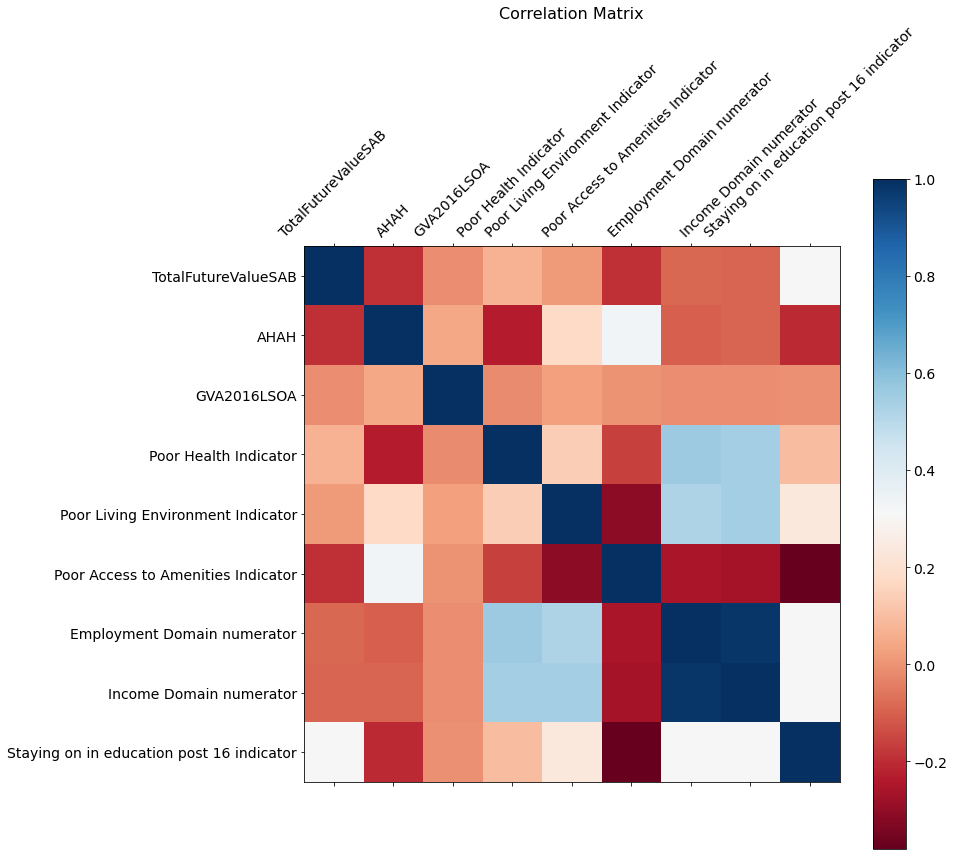

In [20]:
#plotting correlation matrix and checking for multicollinearity
plt.rcParams["axes.grid"] = False
f = plt.figure(figsize=(12, 12))
plt.matshow(gdf_vars_future.corr(), fignum=f.number, cmap= 'RdBu')
#cmap = cm.jet
#cmaps['Perceptually Uniform Sequential'] = [ 'viridis', 'plasma', 'inferno', 'magma', 'cividis']

plt.xticks(range(gdf_vars_future.shape[1]), gdf_vars_future.columns, fontsize=14, rotation=45)
plt.yticks(range(gdf_vars_future.shape[1]), gdf_vars_future.columns, fontsize=14)
cb = plt.colorbar()
cb.ax.tick_params(labelsize=14)
plt.title('Correlation Matrix', fontsize=16)
plt.savefig('ExportedFigures/correlation_matrix1.png', bbox_inches='tight')
#plt.matshow(corr, cmap=cm.jet)

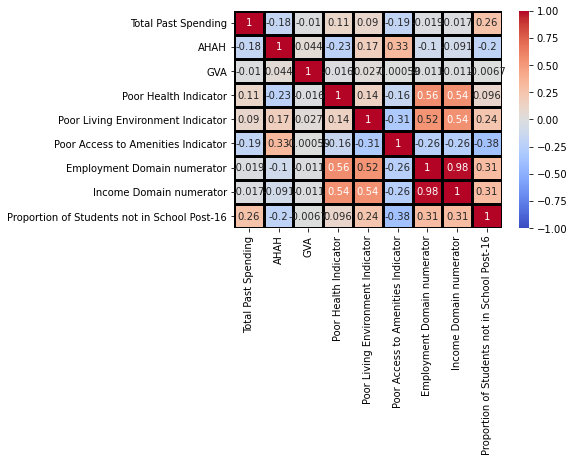

In [21]:
# trying this again with seaborn
# will make look nicer later
# code from this link:
#https://heartbeat.fritz.ai/seaborn-heatmaps-13-ways-to-customize-correlation-matrix-visualizations-f1c49c816f07


sns.heatmap(gdf_vars_past.corr(), annot = True, vmin=-1, vmax=1, center= 0, cmap= 'coolwarm', linewidths=3, linecolor='black')
plt.savefig('ExportedFigures/correlation_matrix2.png', bbox_inches='tight')

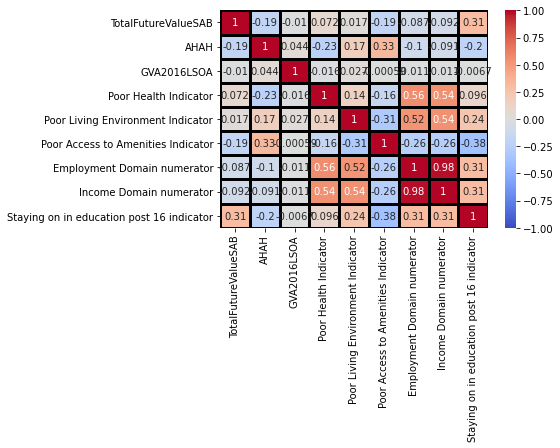

In [22]:
# trying this again with seaborn
# will make look nicer later
# code from this link:
#https://heartbeat.fritz.ai/seaborn-heatmaps-13-ways-to-customize-correlation-matrix-visualizations-f1c49c816f07


sns.heatmap(gdf_vars_future.corr(), annot = True, vmin=-1, vmax=1, center= 0, cmap= 'coolwarm', linewidths=3, linecolor='black')
plt.savefig('ExportedFigures/correlation_matrix3.png', bbox_inches='tight')

### Standardising the Data - Testing Scalars

Make a copy of the df for each transformation

In [24]:
sts = StandardScaler()
rbs = RobustScaler(quantile_range=[25,25])
mms = MinMaxScaler(feature_range=(-1,1))
rbs2 = RobustScaler(quantile_range=[10,90])


In [25]:
gdf_vars_past.info()

<class 'pandas.core.frame.DataFrame'>
Index: 41729 entries, E01000001 to S01013481
Data columns (total 9 columns):
 #   Column                                        Non-Null Count  Dtype  
---  ------                                        --------------  -----  
 0   Total Past Spending                           41729 non-null  float64
 1   AHAH                                          41729 non-null  float64
 2   GVA                                           41729 non-null  float64
 3   Poor Health Indicator                         41729 non-null  float64
 4   Poor Living Environment Indicator             41729 non-null  float64
 5   Poor Access to Amenities Indicator            41729 non-null  float64
 6   Employment Domain numerator                   41729 non-null  float64
 7   Income Domain numerator                       41729 non-null  float64
 8   Proportion of Students not in School Post-16  41729 non-null  float64
dtypes: float64(9)
memory usage: 3.2+ MB


### Standard Scalar

In [26]:
gdf_vars_past1 = gdf_vars_past.copy()

for c in gdf_vars_past1.columns.values:
    gdf_vars_past1[c] = sts.fit_transform(gdf_vars_past1[c].values.reshape(-1,1))
gdf_vars_past1.head(3)

,Total Past Spending,AHAH,GVA,Poor Health Indicator,Poor Living Environment Indicator,Poor Access to Amenities Indicator,Employment Domain numerator,Income Domain numerator,Proportion of Students not in School Post-16
Code,,,,,,,,,
E01000001,-0.51,3.57,83.70,-1.48,1.01,-0.31,-1.05,-1.04,-0.86
E01000002,-0.51,3.29,79.71,-1.33,0.81,-0.58,-0.92,-0.88,0.32
E01000003,-0.51,2.95,91.37,-0.35,2.72,-0.40,-0.45,-0.59,-0.30


In [27]:
gdf_vars_future1 = gdf_vars_future.copy()

for c in gdf_vars_future1.columns.values:
    gdf_vars_future1[c] = sts.fit_transform(gdf_vars_future1[c].values.reshape(-1,1))
gdf_vars_future1.head(3)

,TotalFutureValueSAB,AHAH,GVA2016LSOA,Poor Health Indicator,Poor Living Environment Indicator,Poor Access to Amenities Indicator,Employment Domain numerator,Income Domain numerator,Staying on in education post 16 indicator
Code,,,,,,,,,
E01000001,-0.56,3.57,83.70,-1.48,1.01,-0.31,-1.05,-1.04,-0.86
E01000002,-0.56,3.29,79.71,-1.33,0.81,-0.58,-0.92,-0.88,0.32
E01000003,-0.56,2.95,91.37,-0.35,2.72,-0.40,-0.45,-0.59,-0.30


In [28]:
#gdf_vars_past1.hist(layout=(5, 5), figsize=(12, 12), color='blue', alpha=0.5);

### Robust Scalar - Quantile Range 25-25

In [29]:
gdf_vars_past2 = gdf_vars_past.copy()

for c in gdf_vars_past1.columns.values:
    gdf_vars_past2[c] = rbs.fit_transform(gdf_vars_past2[c].values.reshape(-1,1))
gdf_vars_past2.head(3)

,Total Past Spending,AHAH,GVA,Poor Health Indicator,Poor Living Environment Indicator,Poor Access to Amenities Indicator,Employment Domain numerator,Income Domain numerator,Proportion of Students not in School Post-16
Code,,,,,,,,,
E01000001,"-1,496,244,108.58",29.60,"879,974.92",-0.33,0.24,-0.06,-0.13,-0.13,-0.13
E01000002,"-1,496,244,108.58",27.36,"838,012.38",-0.29,0.20,-0.26,-0.10,-0.10,0.15
E01000003,"-1,496,244,108.58",24.68,"960,672.11",-0.05,0.55,-0.13,-0.02,-0.05,0.00


In [30]:
gdf_vars_future2 = gdf_vars_future.copy()

for c in gdf_vars_future2.columns.values:
    gdf_vars_future2[c] = rbs.fit_transform(gdf_vars_future2[c].values.reshape(-1,1))
gdf_vars_future2.head(3)

,TotalFutureValueSAB,AHAH,GVA2016LSOA,Poor Health Indicator,Poor Living Environment Indicator,Poor Access to Amenities Indicator,Employment Domain numerator,Income Domain numerator,Staying on in education post 16 indicator
Code,,,,,,,,,
E01000001,"-297,390,535.64",29.60,"879,974.92",-0.33,0.24,-0.06,-0.13,-0.13,-0.13
E01000002,"-297,390,535.64",27.36,"838,012.38",-0.29,0.20,-0.26,-0.10,-0.10,0.15
E01000003,"-297,390,535.64",24.68,"960,672.11",-0.05,0.55,-0.13,-0.02,-0.05,0.00


In [31]:
#gdf_vars_past2.hist(layout=(5, 5), figsize=(12, 12), color='blue', alpha=0.5);

### Min Max Scalar

In [32]:
gdf_vars_past3 = gdf_vars_past.copy()

for c in gdf_vars_past3.columns.values:
    gdf_vars_past3[c] = mms.fit_transform(gdf_vars_past3[c].values.reshape(-1,1))
gdf_vars_past3.head(3)

,Total Past Spending,AHAH,GVA,Poor Health Indicator,Poor Living Environment Indicator,Poor Access to Amenities Indicator,Employment Domain numerator,Income Domain numerator,Proportion of Students not in School Post-16
Code,,,,,,,,,
E01000001,-0.84,0.84,0.73,-0.64,-0.52,-0.86,-1.00,-1.00,-0.66
E01000002,-0.84,0.76,0.65,-0.60,-0.56,-0.90,-0.96,-0.94,-0.10
E01000003,-0.84,0.66,0.89,-0.36,-0.15,-0.87,-0.79,-0.84,-0.39


In [33]:
gdf_vars_future3 = gdf_vars_future.copy()

for c in gdf_vars_future3.columns.values:
    gdf_vars_future3[c] = mms.fit_transform(gdf_vars_future3[c].values.reshape(-1,1))
gdf_vars_future3.head(3)

,TotalFutureValueSAB,AHAH,GVA2016LSOA,Poor Health Indicator,Poor Living Environment Indicator,Poor Access to Amenities Indicator,Employment Domain numerator,Income Domain numerator,Staying on in education post 16 indicator
Code,,,,,,,,,
E01000001,-0.70,0.84,0.73,-0.64,-0.52,-0.86,-1.00,-1.00,-0.66
E01000002,-0.70,0.76,0.65,-0.60,-0.56,-0.90,-0.96,-0.94,-0.10
E01000003,-0.70,0.66,0.89,-0.36,-0.15,-0.87,-0.79,-0.84,-0.39


In [34]:
#gdf_vars_future3.hist(layout=(5, 5), figsize=(12, 12), color='blue', alpha=0.5);

### Robust Scalar - Quantile Range 90-10

In [35]:
gdf_vars_past4 = gdf_vars_past.copy()

for c in gdf_vars_past4.columns.values:
    gdf_vars_past4[c] = rbs2.fit_transform(gdf_vars_past4[c].values.reshape(-1,1))
gdf_vars_past4.head(3)

,Total Past Spending,AHAH,GVA,Poor Health Indicator,Poor Living Environment Indicator,Poor Access to Amenities Indicator,Employment Domain numerator,Income Domain numerator,Proportion of Students not in School Post-16
Code,,,,,,,,,
E01000001,-0.16,1.46,"2,260.68",-0.53,0.58,-0.05,-0.40,-0.36,-0.20
E01000002,-0.16,1.35,"2,152.88",-0.47,0.49,-0.19,-0.33,-0.28,0.22
E01000003,-0.16,1.22,"2,467.99",-0.08,1.33,-0.09,-0.07,-0.13,0.00


In [36]:
gdf_vars_future4 = gdf_vars_future.copy()

for c in gdf_vars_future4.columns.values:
    gdf_vars_future4[c] = rbs2.fit_transform(gdf_vars_future4[c].values.reshape(-1,1))
gdf_vars_future4.head(3)

,TotalFutureValueSAB,AHAH,GVA2016LSOA,Poor Health Indicator,Poor Living Environment Indicator,Poor Access to Amenities Indicator,Employment Domain numerator,Income Domain numerator,Staying on in education post 16 indicator
Code,,,,,,,,,
E01000001,-0.05,1.46,"2,260.68",-0.53,0.58,-0.05,-0.40,-0.36,-0.20
E01000002,-0.05,1.35,"2,152.88",-0.47,0.49,-0.19,-0.33,-0.28,0.22
E01000003,-0.05,1.22,"2,467.99",-0.08,1.33,-0.09,-0.07,-0.13,0.00


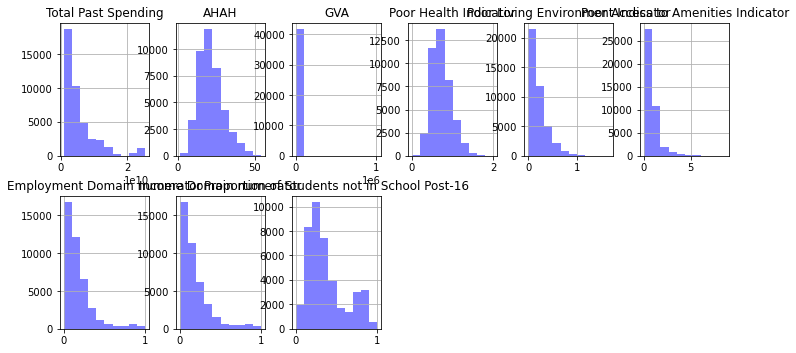

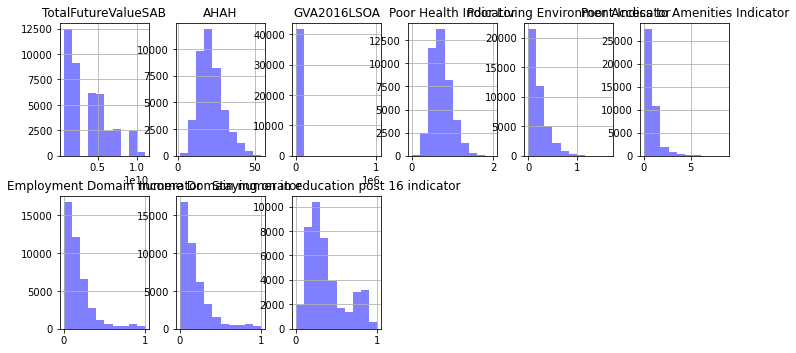

In [37]:
#plot data before pre-processing for comparison

gdf_vars_past.hist(layout=(4, 6), figsize=(12, 12), color='blue', alpha=0.5);
gdf_vars_future.hist(layout=(4, 6), figsize=(12, 12), color='blue', alpha=0.5);

### Standardising the Data - Testing Transformations

### Power Transformer (Yeo-Johnson)

In [38]:
# https://machinelearningmastery.com/power-transforms-with-scikit-learn/

pts1 = PowerTransformer(method='yeo-johnson')
#pts2 = PowerTransformer(method='box-cox') #turns out we cannot use this method as the data must be 'strictly positive', and we have many 0 values
# np.log will also be used

In [39]:
#Standard Scalar + YJ
gdf_vars_past11 = gdf_vars_past1.copy()

for c in gdf_vars_past11.columns.values:
    gdf_vars_past11[c] = pts1.fit_transform(gdf_vars_past11[c].values.reshape(-1,1))
gdf_vars_past11.head(3)

,Total Past Spending,AHAH,GVA,Poor Health Indicator,Poor Living Environment Indicator,Poor Access to Amenities Indicator,Employment Domain numerator,Income Domain numerator,Proportion of Students not in School Post-16
Code,,,,,,,,,
E01000001,-0.45,2.65,2.57,-1.76,1.21,-0.11,-2.15,-1.95,-0.98
E01000002,-0.45,2.50,2.57,-1.54,1.09,-0.67,-1.69,-1.45,0.61
E01000003,-0.45,2.31,2.57,-0.24,1.88,-0.28,-0.34,-0.65,-0.07


In [40]:
gdf_vars_future11 = gdf_vars_future1.copy()

for c in gdf_vars_future11.columns.values:
    gdf_vars_future11[c] = pts1.fit_transform(gdf_vars_future11[c].values.reshape(-1,1))
gdf_vars_future11.head(3)

,TotalFutureValueSAB,AHAH,GVA2016LSOA,Poor Health Indicator,Poor Living Environment Indicator,Poor Access to Amenities Indicator,Employment Domain numerator,Income Domain numerator,Staying on in education post 16 indicator
Code,,,,,,,,,
E01000001,-0.45,2.65,2.57,-1.76,1.21,-0.11,-2.15,-1.95,-0.98
E01000002,-0.45,2.50,2.57,-1.54,1.09,-0.67,-1.69,-1.45,0.61
E01000003,-0.45,2.31,2.57,-0.24,1.88,-0.28,-0.34,-0.65,-0.07


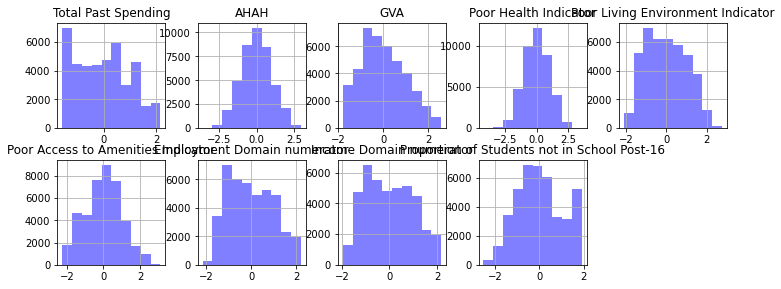

In [41]:
gdf_vars_past11.hist(layout=(5, 5), figsize=(12, 12), color='blue', alpha=0.5);

##### Robust Scalar plus YJ Transformer

In [42]:
#Robust Scalar + YJ
gdf_vars_past21 = gdf_vars_past2.copy()

for c in gdf_vars_past21.columns.values:
    gdf_vars_past21[c] = pts1.fit_transform(gdf_vars_past21[c].values.reshape(-1,1))
gdf_vars_past21.head(3)

,Total Past Spending,AHAH,GVA,Poor Health Indicator,Poor Living Environment Indicator,Poor Access to Amenities Indicator,Employment Domain numerator,Income Domain numerator,Proportion of Students not in School Post-16
Code,,,,,,,,,
E01000001,-0.46,2.81,41.87,-1.76,1.25,-0.10,-2.13,-1.94,-0.96
E01000002,-0.46,2.62,40.58,-1.53,1.11,-0.66,-1.66,-1.43,0.59
E01000003,-0.46,2.40,44.28,-0.25,1.89,-0.26,-0.35,-0.65,-0.09


In [43]:
#Robust Scalar + YJ
gdf_vars_future21 = gdf_vars_future2.copy()

for c in gdf_vars_future21.columns.values:
    gdf_vars_future21[c] = pts1.fit_transform(gdf_vars_future21[c].values.reshape(-1,1))
gdf_vars_future21.head(3)

,TotalFutureValueSAB,AHAH,GVA2016LSOA,Poor Health Indicator,Poor Living Environment Indicator,Poor Access to Amenities Indicator,Employment Domain numerator,Income Domain numerator,Staying on in education post 16 indicator
Code,,,,,,,,,
E01000001,-0.24,2.81,41.87,-1.76,1.25,-0.10,-2.13,-1.94,-0.96
E01000002,-0.24,2.62,40.58,-1.53,1.11,-0.66,-1.66,-1.43,0.59
E01000003,-0.24,2.40,44.28,-0.25,1.89,-0.26,-0.35,-0.65,-0.09


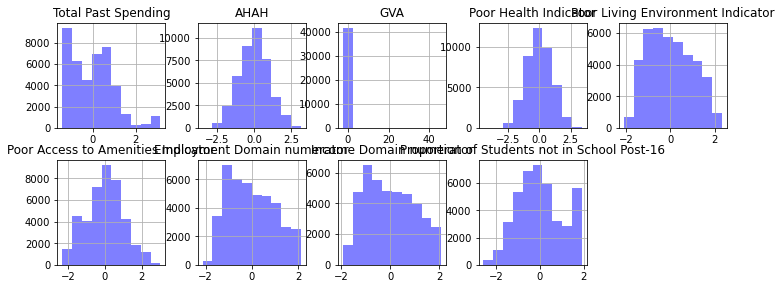

In [44]:
#toggle between the two
gdf_vars_past21.hist(layout=(5, 5), figsize=(12, 12), color='blue', alpha=0.5);
#gdf_vars_future21.hist(layout=(5, 5), figsize=(12, 12), color='blue', alpha=0.5);

##### MinMax scalar plus YJ Transformer

In [45]:
#Minmax Scalar + YJ
gdf_vars_past31 = gdf_vars_past3.copy()

for c in gdf_vars_past31.columns.values:
    gdf_vars_past31[c] = pts1.fit_transform(gdf_vars_past31[c].values.reshape(-1,1))
gdf_vars_past31.head(3)

C:\Users\Yasmine Hujair\anaconda32020\envs\Dissertation\lib\site-packages\numpy\core\_methods.py:232: RuntimeWarning: overflow encountered in multiply
  x = um.multiply(x, x, out=x)
C:\Users\Yasmine Hujair\anaconda32020\envs\Dissertation\lib\site-packages\numpy\core\_methods.py:243: RuntimeWarning: overflow encountered in reduce
  ret = umr_sum(x, axis, dtype, out, keepdims=keepdims, where=where)


,Total Past Spending,AHAH,GVA,Poor Health Indicator,Poor Living Environment Indicator,Poor Access to Amenities Indicator,Employment Domain numerator,Income Domain numerator,Proportion of Students not in School Post-16
Code,,,,,,,,,
E01000001,-0.51,2.55,11.04,-1.73,1.29,-0.18,-1.88,-1.73,-0.97
E01000002,-0.51,2.43,11.04,-1.52,1.14,-0.69,-1.52,-1.33,0.60
E01000003,-0.51,2.27,11.04,-0.26,1.96,-0.34,-0.41,-0.68,-0.11


In [46]:
#Minmax Scalar + YJ
gdf_vars_future31 = gdf_vars_future3.copy()

for c in gdf_vars_future21.columns.values:
    gdf_vars_future31[c] = pts1.fit_transform(gdf_vars_future31[c].values.reshape(-1,1))
gdf_vars_future31.head(3)

C:\Users\Yasmine Hujair\anaconda32020\envs\Dissertation\lib\site-packages\numpy\core\_methods.py:232: RuntimeWarning: overflow encountered in multiply
  x = um.multiply(x, x, out=x)
C:\Users\Yasmine Hujair\anaconda32020\envs\Dissertation\lib\site-packages\numpy\core\_methods.py:243: RuntimeWarning: overflow encountered in reduce
  ret = umr_sum(x, axis, dtype, out, keepdims=keepdims, where=where)


,TotalFutureValueSAB,AHAH,GVA2016LSOA,Poor Health Indicator,Poor Living Environment Indicator,Poor Access to Amenities Indicator,Employment Domain numerator,Income Domain numerator,Staying on in education post 16 indicator
Code,,,,,,,,,
E01000001,-0.49,2.55,11.04,-1.73,1.29,-0.18,-1.88,-1.73,-0.97
E01000002,-0.49,2.43,11.04,-1.52,1.14,-0.69,-1.52,-1.33,0.60
E01000003,-0.49,2.27,11.04,-0.26,1.96,-0.34,-0.41,-0.68,-0.11


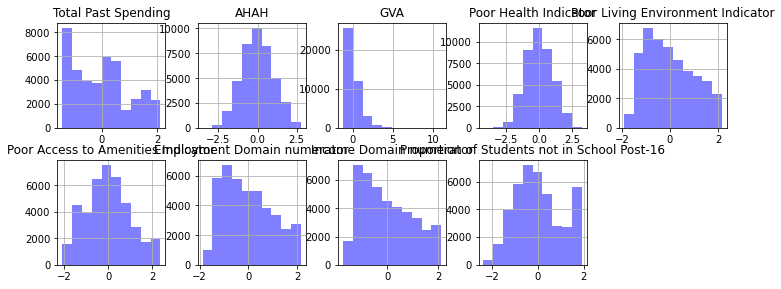

In [47]:
#toggle between the two
gdf_vars_past31.hist(layout=(5, 5), figsize=(12, 12), color='blue', alpha=0.5);
#gdf_vars_future31.hist(layout=(5, 5), figsize=(12, 12), color='blue', alpha=0.5);

##### Robust Scalar (90-10) plus YJ

In [48]:
#Robust Scalar + YJ
gdf_vars_past41 = gdf_vars_past4.copy()

for c in gdf_vars_past41.columns.values:
    gdf_vars_past41[c] = pts1.fit_transform(gdf_vars_past41[c].values.reshape(-1,1))
gdf_vars_past41.head(3)

,Total Past Spending,AHAH,GVA,Poor Health Indicator,Poor Living Environment Indicator,Poor Access to Amenities Indicator,Employment Domain numerator,Income Domain numerator,Proportion of Students not in School Post-16
Code,,,,,,,,,
E01000001,-0.45,2.62,3.62,-1.76,1.22,-0.11,-2.25,-2.02,-0.96
E01000002,-0.45,2.47,3.62,-1.54,1.10,-0.66,-1.73,-1.47,0.59
E01000003,-0.45,2.30,3.62,-0.25,1.88,-0.27,-0.32,-0.63,-0.08


In [49]:
#Robust Scalar + YJ
gdf_vars_future41 = gdf_vars_future4.copy()

for c in gdf_vars_future41.columns.values:
    gdf_vars_future41[c] = pts1.fit_transform(gdf_vars_future41[c].values.reshape(-1,1))
gdf_vars_future41.head(3)

,TotalFutureValueSAB,AHAH,GVA2016LSOA,Poor Health Indicator,Poor Living Environment Indicator,Poor Access to Amenities Indicator,Employment Domain numerator,Income Domain numerator,Staying on in education post 16 indicator
Code,,,,,,,,,
E01000001,-0.42,2.62,3.62,-1.76,1.22,-0.11,-2.25,-2.02,-0.96
E01000002,-0.42,2.47,3.62,-1.54,1.10,-0.66,-1.73,-1.47,0.59
E01000003,-0.42,2.30,3.62,-0.25,1.88,-0.27,-0.32,-0.63,-0.08


In [50]:
gdf_vars_future41 = gdf_vars_future41.rename(columns = {'GVA2016LSOA':'GVA','TotalFutureValueSAB':'Total Future Spending'})


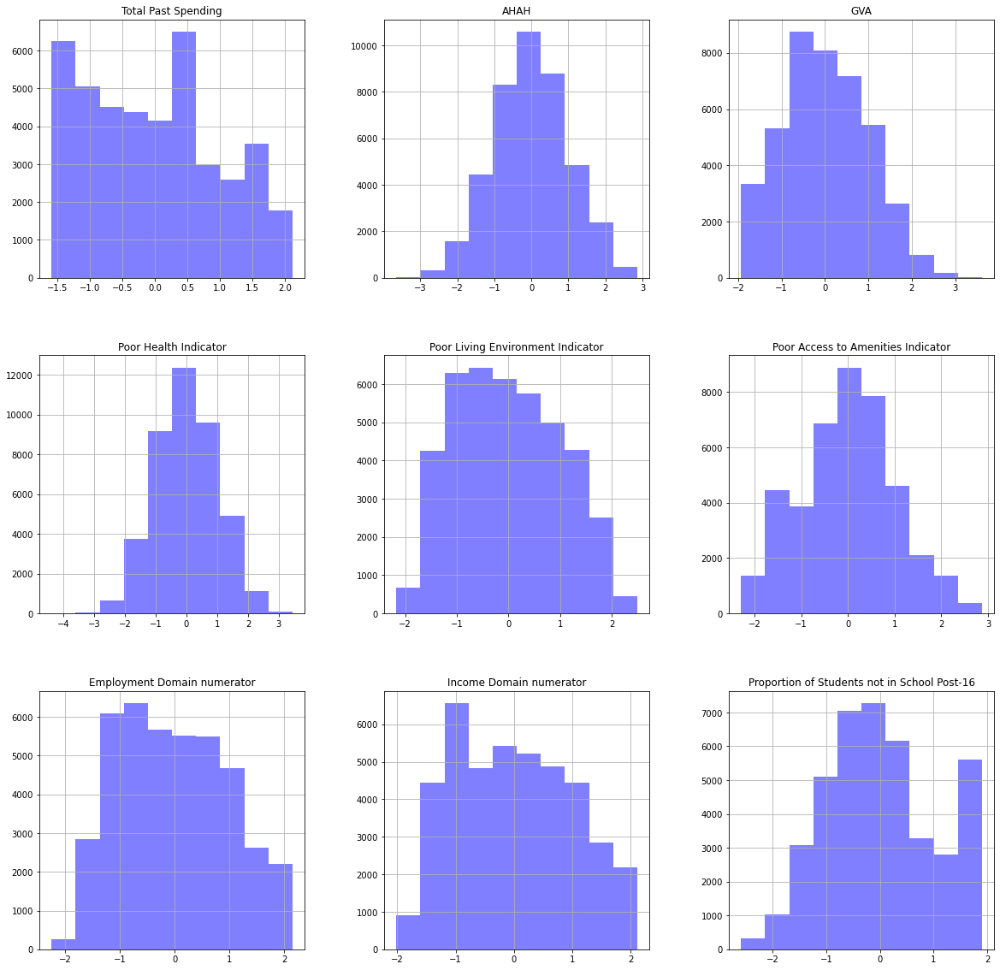

In [51]:
#past histograms
gdf_vars_past41.hist(layout=(3, 3), figsize=(20, 20), color='blue', alpha=0.5);
#gdf_vars_future41.hist(layout=(5, 5), figsize=(12, 12), color='blue', alpha=0.5);
plt.savefig('ExportedFigures/TransformedHistogramsPast41.png', bbox_inches='tight')

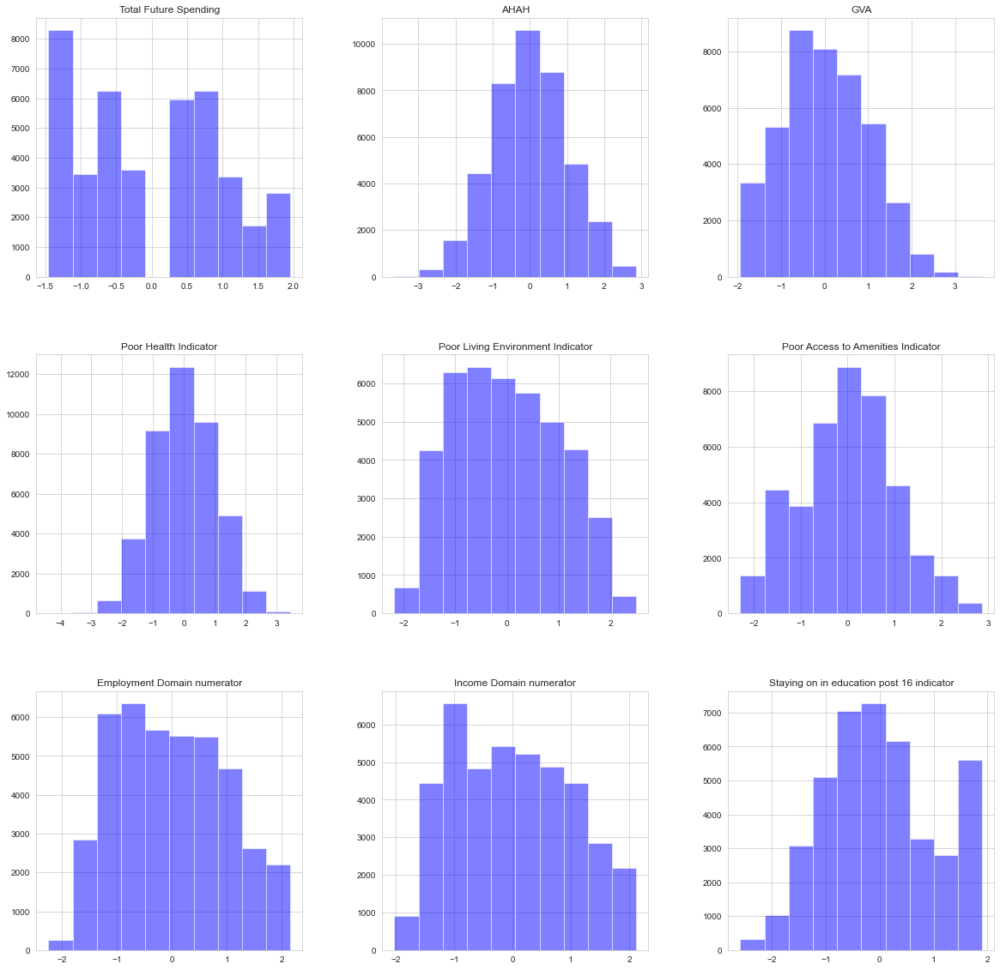

In [52]:
sns.set_style("whitegrid")
gdf_vars_future41.hist(layout=(3, 3), figsize=(20,20), color='blue', alpha=0.5);
plt.savefig('ExportedFigures/TransformedHistogramsFuture41.png', bbox_inches='tight')

##### Standard Scalar plus Log Transformer

In [53]:
#Robust Scalar + YJ
gdf_vars_past12 = gdf_vars_past1.copy()

for c in gdf_vars_past12.columns.values:
    gdf_vars_past12[c] = np.log(gdf_vars_past12[c].values.reshape(-1,1))
gdf_vars_past12.head(3)

C:\Users\Yasmine Hujair\anaconda32020\envs\Dissertation\lib\site-packages\ipykernel_launcher.py:5: RuntimeWarning: invalid value encountered in log
  """


,Total Past Spending,AHAH,GVA,Poor Health Indicator,Poor Living Environment Indicator,Poor Access to Amenities Indicator,Employment Domain numerator,Income Domain numerator,Proportion of Students not in School Post-16
Code,,,,,,,,,
E01000001,NaN,1.27,4.43,NaN,0.01,NaN,NaN,NaN,NaN
E01000002,NaN,1.19,4.38,NaN,-0.21,NaN,NaN,NaN,-1.13
E01000003,NaN,1.08,4.51,NaN,1.00,NaN,NaN,NaN,NaN


In [54]:
#Robust Scalar + YJ
gdf_vars_future12 = gdf_vars_future1.copy()

for c in gdf_vars_future12.columns.values:
    gdf_vars_future12[c] = np.log(gdf_vars_future12[c].values.reshape(-1,1))
gdf_vars_future12.head(3)

C:\Users\Yasmine Hujair\anaconda32020\envs\Dissertation\lib\site-packages\ipykernel_launcher.py:5: RuntimeWarning: invalid value encountered in log
  """


,TotalFutureValueSAB,AHAH,GVA2016LSOA,Poor Health Indicator,Poor Living Environment Indicator,Poor Access to Amenities Indicator,Employment Domain numerator,Income Domain numerator,Staying on in education post 16 indicator
Code,,,,,,,,,
E01000001,NaN,1.27,4.43,NaN,0.01,NaN,NaN,NaN,NaN
E01000002,NaN,1.19,4.38,NaN,-0.21,NaN,NaN,NaN,-1.13
E01000003,NaN,1.08,4.51,NaN,1.00,NaN,NaN,NaN,NaN


In [55]:
#toggle between the two
#gdf_vars_past12.hist(layout=(5, 5), figsize=(12, 12), color='blue', alpha=0.5);
#gdf_vars_future12.hist(layout=(5, 5), figsize=(12, 12), color='blue', alpha=0.5);

##### Robust Scalar (25-25) plus Log Transformer

In [56]:
#Robust Scalar + YJ
gdf_vars_past22 = gdf_vars_past2.copy()

for c in gdf_vars_past22.columns.values:
    gdf_vars_past22[c] = np.log(gdf_vars_past22[c].values.reshape(-1,1))
gdf_vars_past22.head(3)

C:\Users\Yasmine Hujair\anaconda32020\envs\Dissertation\lib\site-packages\ipykernel_launcher.py:5: RuntimeWarning: divide by zero encountered in log
  """
C:\Users\Yasmine Hujair\anaconda32020\envs\Dissertation\lib\site-packages\ipykernel_launcher.py:5: RuntimeWarning: invalid value encountered in log
  """


,Total Past Spending,AHAH,GVA,Poor Health Indicator,Poor Living Environment Indicator,Poor Access to Amenities Indicator,Employment Domain numerator,Income Domain numerator,Proportion of Students not in School Post-16
Code,,,,,,,,,
E01000001,NaN,3.39,13.69,NaN,-1.43,NaN,NaN,NaN,NaN
E01000002,NaN,3.31,13.64,NaN,-1.59,NaN,NaN,NaN,-1.93
E01000003,NaN,3.21,13.78,NaN,-0.60,NaN,NaN,NaN,-inf


In [57]:
#Robust Scalar + YJ
gdf_vars_future22 = gdf_vars_future2.copy()

for c in gdf_vars_future22.columns.values:
    gdf_vars_future22[c] = np.log(gdf_vars_future22[c].values.reshape(-1,1))
gdf_vars_future22.head(3)

C:\Users\Yasmine Hujair\anaconda32020\envs\Dissertation\lib\site-packages\ipykernel_launcher.py:5: RuntimeWarning: divide by zero encountered in log
  """
C:\Users\Yasmine Hujair\anaconda32020\envs\Dissertation\lib\site-packages\ipykernel_launcher.py:5: RuntimeWarning: invalid value encountered in log
  """


,TotalFutureValueSAB,AHAH,GVA2016LSOA,Poor Health Indicator,Poor Living Environment Indicator,Poor Access to Amenities Indicator,Employment Domain numerator,Income Domain numerator,Staying on in education post 16 indicator
Code,,,,,,,,,
E01000001,NaN,3.39,13.69,NaN,-1.43,NaN,NaN,NaN,NaN
E01000002,NaN,3.31,13.64,NaN,-1.59,NaN,NaN,NaN,-1.93
E01000003,NaN,3.21,13.78,NaN,-0.60,NaN,NaN,NaN,-inf


In [58]:
#toggle between the two
#gdf_vars_past22.hist(layout=(5, 5), figsize=(12, 12), color='blue', alpha=0.5);
#gdf_vars_future22.hist(layout=(5, 5), figsize=(12, 12), color='blue', alpha=0.5);

##### Minmax Scalar plus Log Transformer

In [59]:
#Minmax Scalar + YJ
gdf_vars_past32 = gdf_vars_past3.copy()

for c in gdf_vars_past32.columns.values:
    gdf_vars_past32[c] = np.log(gdf_vars_past32[c].values.reshape(-1,1))
gdf_vars_past32.head(3)

C:\Users\Yasmine Hujair\anaconda32020\envs\Dissertation\lib\site-packages\ipykernel_launcher.py:5: RuntimeWarning: invalid value encountered in log
  """
C:\Users\Yasmine Hujair\anaconda32020\envs\Dissertation\lib\site-packages\ipykernel_launcher.py:5: RuntimeWarning: divide by zero encountered in log
  """


,Total Past Spending,AHAH,GVA,Poor Health Indicator,Poor Living Environment Indicator,Poor Access to Amenities Indicator,Employment Domain numerator,Income Domain numerator,Proportion of Students not in School Post-16
Code,,,,,,,,,
E01000001,NaN,-0.17,-0.31,NaN,NaN,NaN,NaN,NaN,NaN
E01000002,NaN,-0.27,-0.43,NaN,NaN,NaN,NaN,NaN,NaN
E01000003,NaN,-0.42,-0.11,NaN,NaN,NaN,NaN,NaN,NaN


In [60]:
#Minmax Scalar + YJ
gdf_vars_future32 = gdf_vars_future3.copy()

for c in gdf_vars_future32.columns.values:
    gdf_vars_future32[c] = np.log(gdf_vars_future32[c].values.reshape(-1,1))
gdf_vars_future32.head(3)

C:\Users\Yasmine Hujair\anaconda32020\envs\Dissertation\lib\site-packages\ipykernel_launcher.py:5: RuntimeWarning: invalid value encountered in log
  """
C:\Users\Yasmine Hujair\anaconda32020\envs\Dissertation\lib\site-packages\ipykernel_launcher.py:5: RuntimeWarning: divide by zero encountered in log
  """


,TotalFutureValueSAB,AHAH,GVA2016LSOA,Poor Health Indicator,Poor Living Environment Indicator,Poor Access to Amenities Indicator,Employment Domain numerator,Income Domain numerator,Staying on in education post 16 indicator
Code,,,,,,,,,
E01000001,NaN,-0.17,-0.31,NaN,NaN,NaN,NaN,NaN,NaN
E01000002,NaN,-0.27,-0.43,NaN,NaN,NaN,NaN,NaN,NaN
E01000003,NaN,-0.42,-0.11,NaN,NaN,NaN,NaN,NaN,NaN


In [61]:
#toggle between the two
#gdf_vars_past32.hist(layout=(5, 5), figsize=(12, 12), color='blue', alpha=0.5);
#gdf_vars_future32.hist(layout=(5, 5), figsize=(12, 12), color='blue', alpha=0.5);

##### Robust Scalar (90-10) plus Log Transformer

In [62]:
#Robust Scalar + YJ
gdf_vars_past42 = gdf_vars_past4.copy()

for c in gdf_vars_past42.columns.values:
    gdf_vars_past42[c] = np.log(gdf_vars_past42[c].values.reshape(-1,1))
gdf_vars_past42.head(3)

C:\Users\Yasmine Hujair\anaconda32020\envs\Dissertation\lib\site-packages\ipykernel_launcher.py:5: RuntimeWarning: divide by zero encountered in log
  """
C:\Users\Yasmine Hujair\anaconda32020\envs\Dissertation\lib\site-packages\ipykernel_launcher.py:5: RuntimeWarning: invalid value encountered in log
  """


,Total Past Spending,AHAH,GVA,Poor Health Indicator,Poor Living Environment Indicator,Poor Access to Amenities Indicator,Employment Domain numerator,Income Domain numerator,Proportion of Students not in School Post-16
Code,,,,,,,,,
E01000001,NaN,0.38,7.72,NaN,-0.55,NaN,NaN,NaN,NaN
E01000002,NaN,0.30,7.67,NaN,-0.71,NaN,NaN,NaN,-1.51
E01000003,NaN,0.20,7.81,NaN,0.29,NaN,NaN,NaN,-inf


In [63]:
#Robust Scalar + YJ
gdf_vars_future42 = gdf_vars_future4.copy()

for c in gdf_vars_future42.columns.values:
    gdf_vars_future42[c] = np.log(gdf_vars_future42[c].values.reshape(-1,1))
gdf_vars_future42.head(3)

C:\Users\Yasmine Hujair\anaconda32020\envs\Dissertation\lib\site-packages\ipykernel_launcher.py:5: RuntimeWarning: divide by zero encountered in log
  """
C:\Users\Yasmine Hujair\anaconda32020\envs\Dissertation\lib\site-packages\ipykernel_launcher.py:5: RuntimeWarning: invalid value encountered in log
  """


,TotalFutureValueSAB,AHAH,GVA2016LSOA,Poor Health Indicator,Poor Living Environment Indicator,Poor Access to Amenities Indicator,Employment Domain numerator,Income Domain numerator,Staying on in education post 16 indicator
Code,,,,,,,,,
E01000001,NaN,0.38,7.72,NaN,-0.55,NaN,NaN,NaN,NaN
E01000002,NaN,0.30,7.67,NaN,-0.71,NaN,NaN,NaN,-1.51
E01000003,NaN,0.20,7.81,NaN,0.29,NaN,NaN,NaN,-inf


In [64]:
#toggle between the two
#gdf_vars_past42.hist(layout=(5, 5), figsize=(12, 12), color='blue', alpha=0.5);
#gdf_vars_future42.hist(layout=(5, 5), figsize=(12, 12), color='blue', alpha=0.5);

## Robust Scalar (90-10) with Power (Yeo-Johnson) Transformation Selected

In [65]:
#sns.histplot(data=gdf_vars_future41, x="Comparative illness and disability ratio indicator")

## First K-Means Clustering
#### Let's see what 6 clusters looks like

In [66]:
#gdf_vars_future41.head()
gdf_vars_past41.info()

<class 'pandas.core.frame.DataFrame'>
Index: 41729 entries, E01000001 to S01013481
Data columns (total 9 columns):
 #   Column                                        Non-Null Count  Dtype  
---  ------                                        --------------  -----  
 0   Total Past Spending                           41729 non-null  float64
 1   AHAH                                          41729 non-null  float64
 2   GVA                                           41729 non-null  float64
 3   Poor Health Indicator                         41729 non-null  float64
 4   Poor Living Environment Indicator             41729 non-null  float64
 5   Poor Access to Amenities Indicator            41729 non-null  float64
 6   Employment Domain numerator                   41729 non-null  float64
 7   Income Domain numerator                       41729 non-null  float64
 8   Proportion of Students not in School Post-16  41729 non-null  float64
dtypes: float64(9)
memory usage: 3.2+ MB


In [67]:
gdf_vars_past41 = gdf_vars_past41.fillna(0)
gdf_vars_future41 = gdf_vars_future41.fillna(0)
gdf_vars_past41.head(3)

,Total Past Spending,AHAH,GVA,Poor Health Indicator,Poor Living Environment Indicator,Poor Access to Amenities Indicator,Employment Domain numerator,Income Domain numerator,Proportion of Students not in School Post-16
Code,,,,,,,,,
E01000001,-0.45,2.62,3.62,-1.76,1.22,-0.11,-2.25,-2.02,-0.96
E01000002,-0.45,2.47,3.62,-1.54,1.10,-0.66,-1.73,-1.47,0.59
E01000003,-0.45,2.30,3.62,-0.25,1.88,-0.27,-0.32,-0.63,-0.08


In [68]:
c_nm   = 'KMeans6' # Clustering name
k_pref = 6 # Number of clusters

kmeanspast = KMeans(n_clusters=k_pref, n_init=25, random_state=42).fit(gdf_vars_past41) # The process
print(kmeanspast.labels_) # The results

[3 0 0 ... 5 5 2]


In [69]:
c_nm   = 'KMeans6' # Clustering name
k_pref = 6 # Number of clusters

kmeansfuture = KMeans(n_clusters=k_pref, n_init=25, random_state=42).fit(gdf_vars_future41) # The process
print(kmeansfuture.labels_) # The results

[3 5 5 ... 2 2 1]


Capture the cluster centers for our table:

In [70]:
centerspast = kmeanspast.cluster_centers_
print(centerspast)
print(type(centerspast))

[[-0.26463283  1.06540728  0.369045   -0.60793349  1.1122059  -0.32413153
   0.16611026  0.25428825 -0.18590687]
 [-0.50534668 -0.21210788  0.01335111  1.00562524  0.46657909 -0.0593517
   1.12564745  1.11762349  0.20560322]
 [ 1.00913062 -0.51968305 -0.85727933 -1.12928102 -0.27922066 -1.30265316
  -0.70010549 -0.75609025  1.61720479]
 [-0.52893841  0.3793209   0.68317865 -0.67183516 -0.84939662  0.91264327
  -0.96205529 -0.94096209 -0.65087864]
 [ 0.38566158 -0.32577209 -0.29867481  0.17077691 -0.48895009  0.3299783
  -0.38881743 -0.43969968 -0.4869343 ]
 [ 1.18750048 -0.8685662  -0.95570143  0.78379994  0.78084543 -1.39997648
   1.03687436  1.02817051  1.24556914]]
<class 'numpy.ndarray'>


In [71]:
centersfuture = kmeansfuture.cluster_centers_
print(centersfuture)
print(type(centersfuture))

[[ 0.08936713 -0.35881513 -0.0534496   0.41483567 -0.3314103   0.25922332
  -0.02693239 -0.0707413  -0.33647154]
 [ 1.06309528 -0.50309572 -0.85595957 -1.11315849 -0.27600221 -1.27440591
  -0.70454243 -0.75727375  1.58196911]
 [ 1.19875654 -0.87220976 -0.92288053  0.80861831  0.76262814 -1.38101931
   1.03822655  1.0274306   1.22351289]
 [-0.26417821  0.31010071  0.47979976 -0.65195998 -0.89013237  0.89792639
  -1.02395517 -1.01323703 -0.69016189]
 [-0.68530165 -0.09892953 -0.04690978  1.01273114  0.6780565  -0.13483992
   1.30508508  1.30378557  0.31805201]
 [-0.27949145  1.07557004  0.36643083 -0.66686875  1.11177421 -0.33485552
   0.09030273  0.18429273 -0.2387542 ]]
<class 'numpy.ndarray'>


In [72]:
# https://datatofish.com/numpy-array-to-pandas-dataframe/
# convert the array to a dataframe

six_clusters_past = pd.DataFrame(centerspast, columns = gdf_vars_past.columns, index = ['Cluster 1 Center','Cluster 2 Center','Cluster 3 Center', 'Cluster 4 Center', 'Cluster 5 Center', 'Cluster 6 Center'])
six_clusters_future = pd.DataFrame(centersfuture, columns = gdf_vars_future.columns, index = ['Cluster 1 Center','Cluster 2 Center','Cluster 3 Center', 'Cluster 4 Center', 'Cluster 5 Center', 'Cluster 6 Center'])
print(six_clusters_past)
print(six_clusters_future)

                  Total Past Spending  AHAH   GVA  Poor Health Indicator  \
Cluster 1 Center                -0.26  1.07  0.37                  -0.61   
Cluster 2 Center                -0.51 -0.21  0.01                   1.01   
Cluster 3 Center                 1.01 -0.52 -0.86                  -1.13   
Cluster 4 Center                -0.53  0.38  0.68                  -0.67   
Cluster 5 Center                 0.39 -0.33 -0.30                   0.17   
Cluster 6 Center                 1.19 -0.87 -0.96                   0.78   

                  Poor Living Environment Indicator  \
Cluster 1 Center                               1.11   
Cluster 2 Center                               0.47   
Cluster 3 Center                              -0.28   
Cluster 4 Center                              -0.85   
Cluster 5 Center                              -0.49   
Cluster 6 Center                               0.78   

                  Poor Access to Amenities Indicator  \
Cluster 1 Center         

In [73]:
#https://note.nkmk.me/en/python-pandas-t-transpose/#:~:text=Use%20the%20T%20attribute%20or,columns%20swapped%20(%3D%20transposed%20object).
# Need to transpose the dataframe (swap the comuns and rows) to get it into desired format

#six_clusters_past = six_clusters_past.T
#six_clusters_future = six_clusters_future.T
#print(six_clusters_past)

In [74]:
#### Get the national average of all msoas for each column from gdf_vars12 - yeo-johnson power transformed
#### Then add it as the first column of the six_clusters df

#av_gdf_vars12_column = gdf_vars12.mean(axis=0)
#av_gdf_vars12_column
#gdf_vars12.head()

#av_gdf_vars = gdf_vars.mean(axis=0)
#av_gdf_vars

In [75]:
#inverse_transform(av_gdf_vars12_column)

In [76]:
#reset index

gdf_vars_past41 = gdf_vars_past41.reset_index()
gdf_vars_future41 = gdf_vars_future41.reset_index()
gdf_vars_future41.head()

,Code,Total Future Spending,AHAH,GVA,Poor Health Indicator,Poor Living Environment Indicator,Poor Access to Amenities Indicator,Employment Domain numerator,Income Domain numerator,Staying on in education post 16 indicator
0,E01000001,-0.42,2.62,3.62,-1.76,1.22,-0.11,-2.25,-2.02,-0.96
1,E01000002,-0.42,2.47,3.62,-1.54,1.10,-0.66,-1.73,-1.47,0.59
2,E01000003,-0.42,2.30,3.62,-0.25,1.88,-0.27,-0.32,-0.63,-0.08
3,E01000005,-0.42,2.39,3.62,-0.41,1.83,-0.78,0.11,0.27,0.54
4,E01000006,-0.65,1.68,0.17,-1.61,1.12,-0.14,-0.23,0.27,-1.43


Now capture the labels (i.e. clusters) and write them to a data series that we store on the result set df (`results`):

In [77]:
#create results dataframe
results_past = gdf_vars_past41.merge(lsoas, on='Code').set_index('Code')
results_future = gdf_vars_future41.merge(lsoas, on='Code').set_index('Code')
results_past.head()

,Total Past Spending,AHAH,GVA,Poor Health Indicator,Poor Living Environment Indicator,Poor Access to Amenities Indicator,Employment Domain numerator,Income Domain numerator,Proportion of Students not in School Post-16,Name,Shape_Leng,Shape_Area,geometry
Code,,,,,,,,,,,,,
E01000001,-0.45,2.62,3.62,-1.76,1.22,-0.11,-2.25,-2.02,-0.96,City of London 001A,"2,635.77","129,865.31","POLYGON ((532151.537 181867.433, 532152.500 18..."
E01000002,-0.45,2.47,3.62,-1.54,1.10,-0.66,-1.73,-1.47,0.59,City of London 001B,"2,707.88","228,419.63","POLYGON ((532634.497 181926.016, 532632.048 18..."
E01000003,-0.45,2.30,3.62,-0.25,1.88,-0.27,-0.32,-0.63,-0.08,City of London 001C,"1,224.64","59,054.35","POLYGON ((532153.703 182165.155, 532158.250 18..."
E01000005,-0.45,2.39,3.62,-0.41,1.83,-0.78,0.11,0.27,0.54,City of London 001E,"2,275.81","189,577.71","POLYGON ((533619.062 181402.364, 533639.868 18..."
E01000006,-0.88,1.68,0.17,-1.61,1.12,-0.14,-0.23,0.27,-1.43,Barking and Dagenham 016A,"1,966.09","146,537.00","POLYGON ((545126.852 184310.838, 545145.213 18..."


In [78]:
# Add it to the data frame
results_past[c_nm] = pd.Series(kmeanspast.labels_, index=gdf_vars_past.index)
results_future[c_nm] = pd.Series(kmeansfuture.labels_, index=gdf_vars_future.index)

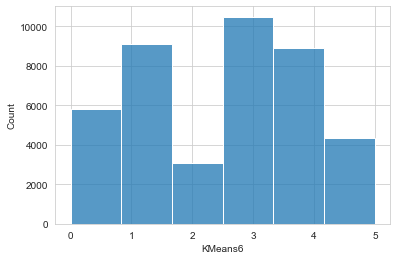

In [79]:
# How are the clusters distributed?
ax = sns.histplot(data=results_past, x=c_nm, bins=k_pref);

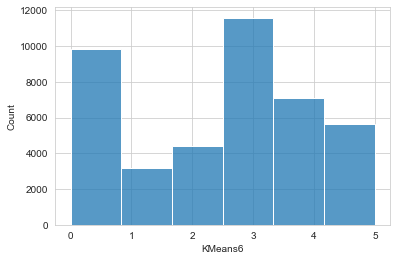

In [80]:
# How are the clusters distributed?
ax = sns.histplot(data=results_future, x=c_nm, bins=k_pref);

In [81]:
# Plotting a selection of variables against one another

#cols_to_plot = np.random.choice(gdf_vars_past41.columns.values, 4, replace=False)

#cols_to_plot = ['Total Past Spending', 'AHAH' ,'GDP','GVA' ,'Poor Health Indicator','Poor Living Environment Indicator' ,
#'Poor Access to Amenities Indicator' ,'Employment Domain numerator','Income Domain numerator' , 'Proportion of Students not in School Post-16']

#sns.set(style="white")
#sns.pairplot(results_past, 
#             vars=cols_to_plot, 
#             hue=c_nm, markers=".", height=3, diag_kind='kde');

In [82]:
past_cols_to_plot = ['Total Past Spending', 'AHAH',
'GVA' ,
'Poor Health Indicator',
'Poor Living Environment Indicator' ,
'Poor Access to Amenities Indicator' ,
'Employment Domain numerator',
'Income Domain numerator' ,
 'Proportion of Students not in School Post-16']

In [83]:
#cols_to_plot_future = np.random.choice(gdf_vars_future41.columns.values, 4, replace=False)

#future_cols_to_plot = ['Total Planned Future Spending Spending', 'AHAH' ,'GDP','GVA' ,'Poor Health Indicator','Poor Living Environment Indicator' ,
#'Poor Access to Amenities Indicator' ,'Employment Domain numerator','Income Domain numerator' , 'Proportion of Students not in School Post-16']


#sns.set(style="white")
#sns.pairplot(results_future, 
#             vars=cols_to_plot_future, 
#             hue=c_nm, markers=".", height=3, diag_kind='kde');

In [84]:
#recreate gdfs
results_past_gdf = gpd.GeoDataFrame(results_past, crs = "epsg:27700")
results_future_gdf = gpd.GeoDataFrame(results_future, crs = "epsg:27700")

In [85]:
#Set code column back to index
gdf_vars_past41 = gdf_vars_past41.set_index('Code')
#set Index to Code
gdf_vars_future41 = gdf_vars_future41.set_index('Code')

Maps below, which take some time to run and were not instrumental to the analysis.

In [86]:
#fig, ax = plt.subplots(figsize=(16,10))
#fig.suptitle(f"{c_nm} Results (k={k_pref})", fontsize=20, y=0.92)
#results_past_gdf.plot(column=c_nm, ax=ax, linewidth=0, zorder=0, categorical=True, legend=True);

In [87]:
#fig, ax = plt.subplots(figsize=(16,10))
#fig.suptitle(f"{c_nm} Results (k={k_pref})", fontsize=20, y=0.92)
#results_future_gdf.plot(column=c_nm, ax=ax, linewidth=0, zorder=0, categorical=True, legend=True);

In [88]:
#normalised_national.set_index('Cluster', inplace = True)

#fig, ax = plt.subplots(figsize=(10, 15))
#sns.set(font_scale=1.7)
#sns.set_style("whitegrid")
#ax = sns.heatmap(six_clusters_past, cmap = "viridis",
#           linewidth=0.3,
#           cbar_kws={'label': 'Magnitude of Normalised Variable',
#                    'orientation':'horizontal',
#                    'pad':0.3})


#plt.savefig('National-Clusters-Heatmap.png',bbox_inches='tight')

In [89]:
#normalised_national.set_index('Cluster', inplace = True)

#fig, ax = plt.subplots(figsize=(10, 15))
#sns.set(font_scale=1.7)
#sns.set_style("whitegrid")
#ax = sns.heatmap(six_clusters_future, cmap = "viridis",
#           linewidth=0.3,
#           cbar_kws={'label': 'Magnitude of Normalised Variable',
#                    'orientation':'horizontal',
#                    'pad':0.3})


#plt.savefig('National-Clusters-Heatmap.png',bbox_inches='tight')

#### The Number of Clusters

Note, these algorithms may take some time to run

In [69]:
#Set code column back to index
#gdf_vars_past41 = gdf_vars_past41.set_index('Code')

# Adapted from: http://scikit-learn.org/stable/auto_examples/cluster/plot_kmeans_silhouette_analysis.html
from sklearn.metrics import davies_bouldin_score, silhouette_samples, silhouette_score

x = []
y = []

for k in range(2,21):
    
    #############
    # Do the clustering using the main columns
    kmeans_past = KMeans(n_clusters=k, n_init=25, random_state=42).fit(gdf_vars_past41)
    
    # Calculate the overall silhouette score
    silhouette_avg = silhouette_score(gdf_vars_past41, kmeans_past.labels_)
    
    y.append(k)
    x.append(silhouette_avg)
    
    print('.', end='')

print()
print(f"Largest silhouette score was {max(x):6.4f} for k={y[x.index(max(x))]}")

plt.plot(y, x)
plt.gcf().suptitle("Average Silhouette Scores");

KeyboardInterrupt: 

In [ ]:


# Adapted from: http://scikit-learn.org/stable/auto_examples/cluster/plot_kmeans_silhouette_analysis.html
from sklearn.metrics import davies_bouldin_score, silhouette_samples, silhouette_score

x = []
y = []

for k in range(2,21):
    
    #############
    # Do the clustering using the main columns
    kmeans_future = KMeans(n_clusters=k, n_init=25, random_state=42).fit(gdf_vars_future41)
    
    # Calculate the overall silhouette score
    silhouette_avg = silhouette_score(gdf_vars_future41, kmeans_future.labels_)
    
    y.append(k)
    x.append(silhouette_avg)
    
    print('.', end='')

print()
print(f"Largest silhouette score was {max(x):6.4f} for k={y[x.index(max(x))]}")

plt.plot(y, x)
plt.gcf().suptitle("Average Silhouette Scores");

In [94]:
#https://realpython.com/k-means-clustering-python/
# SSE ELBOW METHOD 

In [95]:
# A list holds the SSE values for each k
sse1 = []
for k in range(1, 21):
    kmeans_past = KMeans(n_clusters=k, n_init=25, random_state=42)
    kmeans_past.fit(gdf_vars_past41)
    sse1.append(kmeans_past.inertia_)

print(sse1)

[375561.00000000367, 273299.36089419096, 237416.36110507525, 216990.20222337707, 198805.57125910453, 184341.05202816284, 173645.397774413, 163995.86063747326, 157177.53357747855, 151595.76316920965, 146642.2777491648, 141917.91288961633, 137944.46155017958, 134287.1028768456, 131093.53275659372, 127986.20586753952, 125105.62537507838, 122738.08266670915, 120880.270197282, 118943.17871007997]


In [96]:
# A list holds the SSE values for each k
sse2 = []
for k in range(1, 21):
    kmeans_future = KMeans(n_clusters=k, n_init=25, random_state=42)
    kmeans_future.fit(gdf_vars_future41)
    sse2.append(kmeans_future.inertia_)
    
print(sse2)

[375561.0000000017, 273576.79413696885, 236844.13844432152, 216572.22487619688, 198700.4298349861, 184034.4356853989, 172574.61347546865, 162878.96100986577, 155538.17731745925, 149818.13090355898, 144810.5520535123, 140032.62990545676, 135672.46498192404, 131897.89416137795, 128361.92307037445, 125489.02228167816, 122450.44145486526, 120165.45736480172, 117916.71381878063, 116008.8359899688]


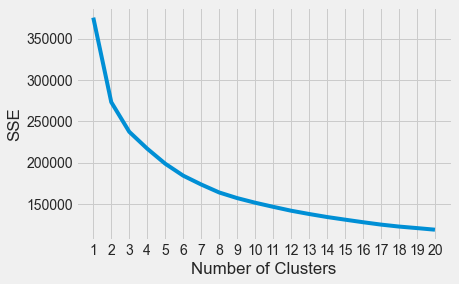

In [97]:
plt.style.use("fivethirtyeight")
plt.plot(range(1, 21), sse1)
plt.xticks(range(1, 21))
plt.xlabel("Number of Clusters")
plt.ylabel("SSE")
#plt.title('SSE Curve for PowerTransformed Clusters')

plt.savefig('SSECurvePast.png', bbox_inches='tight')
plt.show()

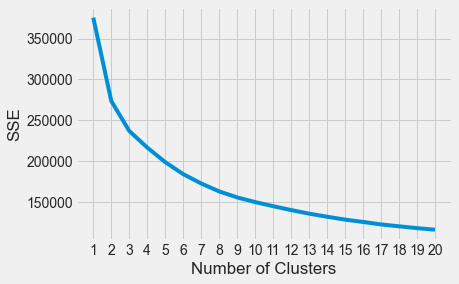

In [98]:
plt.style.use("fivethirtyeight")
plt.plot(range(1, 21), sse2)
plt.xticks(range(1, 21))
plt.xlabel("Number of Clusters")
plt.ylabel("SSE")
#plt.title('SSE Curve for PowerTransformed Clusters')

plt.savefig('SSECurveFuture.png', bbox_inches='tight')
plt.show()

### Silhouette Coefficients Calculations

In [ ]:
silhouette_coefficients1 = []

# Notice you start at 2 clusters for silhouette coefficient
for k in range(2, 21):
    kmeans_past = KMeans(n_clusters=k, n_init=25, random_state=42)
    kmeans_past.fit(gdf_vars_past41)
    score = silhouette_score(gdf_vars_past41, kmeans_past.labels_)
    silhouette_coefficients1.append(score)
    
print(silhouette_coefficients1)

In [ ]:
len(silhouette_coefficients1)

In [ ]:
silhouette_coefficients2 = []

# Notice you start at 2 clusters for silhouette coefficient
for k in range(2, 21):
    kmeans_future = KMeans(n_clusters=k, n_init=25, random_state=42)
    kmeans_future.fit(gdf_vars_future41)
    score = silhouette_score(gdf_vars_future41, kmeans_future.labels_)
    silhouette_coefficients2.append(score)
    
print(silhouette_coefficients2)

In [ ]:
len(silhouette_coefficients2)

In [ ]:
plt.style.use("fivethirtyeight")
plt.plot(range(1, 39), silhouette_coefficients1)
plt.xticks(range(1, 39)) 
plt.xlabel("Number of Clusters")
plt.ylabel("Silhouette Coefficient")
#plt.title('Silhouette Coefficient Plot for\nPowerTransformed Clusters')
#plt.savefig('PwrTran_clusters_Silhouette.png', bbox_inches='tight')
plt.show()

In [ ]:
plt.style.use("fivethirtyeight")
plt.plot(range(1, 39), silhouette_coefficients2)
plt.xticks(range(1, 39)) 
plt.xlabel("Number of Clusters")
plt.ylabel("Silhouette Coefficient")
#plt.title('Silhouette Coefficient Plot for\nPowerTransformed Clusters')
#plt.savefig('PwrTran_clusters_Silhouette.png', bbox_inches='tight')
plt.show()

### Davies-Bouldin Index

In [ ]:
db_index1 = []

for k in range(2, 21):
    kmeans_past = KMeans(n_clusters=k, n_init=25, random_state=42)
    kmeans_past.fit(gdf_vars_past41)
    
    value = davies_bouldin_score(gdf_vars_past41,kmeans_past.labels_)
    db_index1.append(value)
    
print(db_index1)

In [ ]:
plt.style.use("fivethirtyeight")
plt.plot(range(2,21), db_index1)
plt.xticks(range(2, 21)) 
plt.xlabel("Number of Clusters")
plt.ylabel("Davies-Bouldin Values")
#plt.savefig('_clusters_Silhouette.png', bbox_inches='tight')
plt.show()

In [ ]:
db_index2 = []

for k in range(2, 21):
    kmeans_future = KMeans(n_clusters=k, n_init=25, random_state=42)
    kmeans_future.fit(gdf_vars_future41)
    
    value = davies_bouldin_score(gdf_vars_future41,kmeans_future.labels_)
    db_index2.append(value)
    
print(db_index2)

In [ ]:
plt.style.use("fivethirtyeight")
plt.plot(range(2,21), db_index2)
plt.xticks(range(2, 21)) 
plt.xlabel("Number of Clusters")
plt.ylabel("Davies-Bouldin Values")
#plt.savefig('_clusters_Silhouette.png', bbox_inches='tight')
plt.show()

In [91]:
# 9 clusters appear to be optimal
# How we justify our selection of whatever number of clusters is the question

## Second K-Means Clustering
#### Let's see what 9 clusters look like

In [90]:
c_nm9   = 'KMeans9' # Clustering name
k_pref = 9 # Number of clusters

kmeans9_past = KMeans(n_clusters=k_pref, n_init=25, random_state=42).fit(gdf_vars_past41) # The process

print(kmeans9_past.labels_)

[7 8 8 ... 6 6 1]


In [91]:
c_nm9   = 'KMeans9' # Clustering name
k_pref = 9 # Number of clusters

kmeans9_future = KMeans(n_clusters=k_pref, n_init=25, random_state=42).fit(gdf_vars_future41) # The process

print(kmeans9_future.labels_)

[8 2 2 ... 1 1 7]


Capture the cluster centers for our table:

In [92]:
centers9_past = kmeans9_past.cluster_centers_
print(centers9_past)

[[-0.74540416 -0.33589364  0.60238738  0.42489751 -0.29351119  0.27721708
   0.1999883   0.19066487 -0.1583806 ]
 [ 1.00964105 -0.5116443  -0.86172058 -1.13961781 -0.30500473 -1.30659146
  -0.71026858 -0.76557709  1.63459637]
 [ 0.42115401 -0.1568542  -0.45189334  1.17661604  0.2997921  -0.0682686
   0.88998215  0.86741833 -0.10593294]
 [-0.31852904  1.20281321  0.54981458 -0.44250683 -0.72794166  1.68990366
  -0.85515578 -0.81658803 -0.46225165]
 [ 0.6066531  -0.26305985 -0.55299329 -0.02973245 -0.65750396  0.39659059
  -0.69484887 -0.75777768 -0.63198582]
 [-1.08482618 -0.02836518  0.20015667  0.70016069  1.24353314 -0.28978264
   1.71709123  1.71460203  0.78187599]
 [ 1.12775052 -1.01042234 -1.02392457  0.67402205  0.82819615 -1.5783699
   1.02587212  1.01479589  1.43769806]
 [-0.54769852 -0.0459897   0.73214409 -0.88764605 -0.87943096  0.49897996
  -1.10300571 -1.08248464 -0.77461713]
 [-0.22523798  1.14068736  0.32228287 -0.70642163  1.16614265 -0.39214468
   0.10343924  0.2015734

In [93]:
centers9_future = kmeans9_future.cluster_centers_
print(centers9_future)

[[ 1.0122716  -0.19134049 -0.00529897  1.06206666  0.31962007 -0.0215932
   0.68384482  0.64506472 -0.1544319 ]
 [ 1.13141914 -1.02307763 -1.03822703  0.67835718  0.8239638  -1.58209243
   1.02578354  1.01383413  1.44313575]
 [-0.29901592  1.11296133  0.37237701 -0.71963649  1.15549222 -0.37133408
   0.08731936  0.18715976 -0.21777903]
 [-0.93594486 -0.0926216   0.08839375 -0.49885122 -0.82824578  0.43012415
  -0.8664632  -0.89530658 -0.6703344 ]
 [-1.02784714  0.01091293 -0.0266287   0.72159742  1.23826266 -0.30108249
   1.64368663  1.65328396  0.67481508]
 [ 0.84913667 -0.27966295  0.3787459  -0.32340278 -0.69941277  0.47343728
  -0.8360672  -0.84945227 -0.6431446 ]
 [-0.91526642 -0.28466414 -0.13507401  0.78766462 -0.24391206  0.16237734
   0.54600679  0.53018354 -0.10130237]
 [ 1.05513908 -0.48268935 -0.8713617  -1.12743542 -0.295308   -1.27946112
  -0.70426768 -0.75755131  1.61893112]
 [-0.24540667  1.17333323  0.71526693 -0.62310841 -0.74624283  1.65884966
  -0.93658438 -0.880167

In [94]:
# https://datatofish.com/numpy-array-to-pandas-dataframe/
# convert the array to a dataframe

nine_clusters_past = pd.DataFrame(centers9_past, columns = gdf_vars_past41.columns, index = ['Cluster 1 Center','Cluster 2 Center','Cluster 3 Center', 'Cluster 4 Center', 'Cluster 5 Center', 'Cluster 6 Center', 'Cluster 7 Center', 'Cluster 8 Center', 'Cluster 9 Center'])
print(nine_clusters_past)

                  Total Past Spending  AHAH   GVA  Poor Health Indicator  \
Cluster 1 Center                -0.75 -0.34  0.60                   0.42   
Cluster 2 Center                 1.01 -0.51 -0.86                  -1.14   
Cluster 3 Center                 0.42 -0.16 -0.45                   1.18   
Cluster 4 Center                -0.32  1.20  0.55                  -0.44   
Cluster 5 Center                 0.61 -0.26 -0.55                  -0.03   
Cluster 6 Center                -1.08 -0.03  0.20                   0.70   
Cluster 7 Center                 1.13 -1.01 -1.02                   0.67   
Cluster 8 Center                -0.55 -0.05  0.73                  -0.89   
Cluster 9 Center                -0.23  1.14  0.32                  -0.71   

                  Poor Living Environment Indicator  \
Cluster 1 Center                              -0.29   
Cluster 2 Center                              -0.31   
Cluster 3 Center                               0.30   
Cluster 4 Center   

In [95]:
# https://datatofish.com/numpy-array-to-pandas-dataframe/
# convert the array to a dataframe

nine_clusters_future = pd.DataFrame(centers9_future, columns = gdf_vars_future41.columns, index = ['Cluster 1 Center','Cluster 2 Center','Cluster 3 Center', 'Cluster 4 Center', 'Cluster 5 Center', 'Cluster 6 Center', 'Cluster 7 Center', 'Cluster 8 Center', 'Cluster 9 Center'])
print(nine_clusters_future)

                  Total Future Spending  AHAH   GVA  Poor Health Indicator  \
Cluster 1 Center                   1.01 -0.19 -0.01                   1.06   
Cluster 2 Center                   1.13 -1.02 -1.04                   0.68   
Cluster 3 Center                  -0.30  1.11  0.37                  -0.72   
Cluster 4 Center                  -0.94 -0.09  0.09                  -0.50   
Cluster 5 Center                  -1.03  0.01 -0.03                   0.72   
Cluster 6 Center                   0.85 -0.28  0.38                  -0.32   
Cluster 7 Center                  -0.92 -0.28 -0.14                   0.79   
Cluster 8 Center                   1.06 -0.48 -0.87                  -1.13   
Cluster 9 Center                  -0.25  1.17  0.72                  -0.62   

                  Poor Living Environment Indicator  \
Cluster 1 Center                               0.32   
Cluster 2 Center                               0.82   
Cluster 3 Center                               1.16   

In [96]:
#https://note.nkmk.me/en/python-pandas-t-transpose/#:~:text=Use%20the%20T%20attribute%20or,columns%20swapped%20(%3D%20transposed%20object).
# Need to transpose the dataframe (swap the comuns and rows) to get it into desired format

nine_clusters_past = nine_clusters_past.T
print(nine_clusters_past)

                                              Cluster 1 Center  \
Total Past Spending                                      -0.75   
AHAH                                                     -0.34   
GVA                                                       0.60   
Poor Health Indicator                                     0.42   
Poor Living Environment Indicator                        -0.29   
Poor Access to Amenities Indicator                        0.28   
Employment Domain numerator                               0.20   
Income Domain numerator                                   0.19   
Proportion of Students not in School Post-16             -0.16   

                                              Cluster 2 Center  \
Total Past Spending                                       1.01   
AHAH                                                     -0.51   
GVA                                                      -0.86   
Poor Health Indicator                                    -1.14   
Poor Livi

In [97]:
#https://note.nkmk.me/en/python-pandas-t-transpose/#:~:text=Use%20the%20T%20attribute%20or,columns%20swapped%20(%3D%20transposed%20object).
# Need to transpose the dataframe (swap the comuns and rows) to get it into desired format

nine_clusters_future = nine_clusters_future.T
print(nine_clusters_future)

                                           Cluster 1 Center  Cluster 2 Center  \
Total Future Spending                                  1.01              1.13   
AHAH                                                  -0.19             -1.02   
GVA                                                   -0.01             -1.04   
Poor Health Indicator                                  1.06              0.68   
Poor Living Environment Indicator                      0.32              0.82   
Poor Access to Amenities Indicator                    -0.02             -1.58   
Employment Domain numerator                            0.68              1.03   
Income Domain numerator                                0.65              1.01   
Staying on in education post 16 indicator             -0.15              1.44   

                                           Cluster 3 Center  Cluster 4 Center  \
Total Future Spending                                 -0.30             -0.94   
AHAH                       

Now capture the labels (i.e. clusters) and write them to a data series that we store on the result set df (`rs`):

In [98]:
# Add it to the data frame
results_past[c_nm9] = pd.Series(kmeans9_past.labels_, index=gdf_vars_past41.index)
results_future[c_nm9] = pd.Series(kmeans9_future.labels_, index=gdf_vars_future41.index)

In [99]:
# Add it to the geodata frame
results_past_gdf[c_nm9] = pd.Series(kmeans9_past.labels_, index=gdf_vars_past41.index)
results_future_gdf[c_nm9] = pd.Series(kmeans9_future.labels_, index=gdf_vars_future41.index)

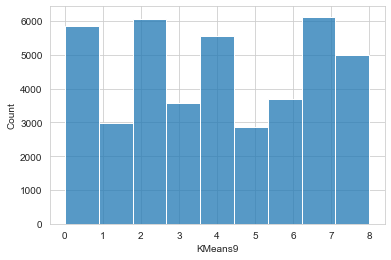

In [100]:
# How are the clusters distributed?
ax = sns.histplot(data=results_past, x=c_nm9, bins=k_pref);
#plt.savefig('ExportedFigures/PastvFuturePlot.png',bbox_inches='tight')

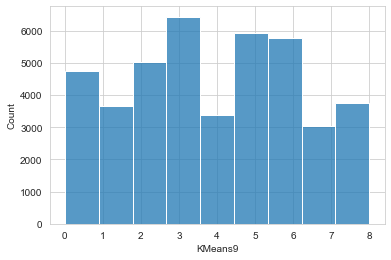

In [101]:
ax = sns.histplot(data=results_future, x=c_nm9, bins=k_pref);

In [102]:
sns.set(style="white")
sns.pairplot(results_past, 
             vars=cols_to_plot, 
             hue=c_nm9, markers=".", height=3, diag_kind='kde');

NameError: name 'cols_to_plot' is not defined

In [103]:
#cols_to_plot_future = ['TotalFutureValueSAB','AHAH', 'GDP2019LSOA','GVA2016LSOA', 'Health', 'Environment', 'Access',
#'Employment Domain numerator', 'Income Domain numerator','Staying on in education post 16 indicator']#
#sns.set(style="white")
#sns.pairplot(results_future, 
#             vars=cols_to_plot_future, 
#             hue=c_nm9, markers=".", height=3, diag_kind='kde');

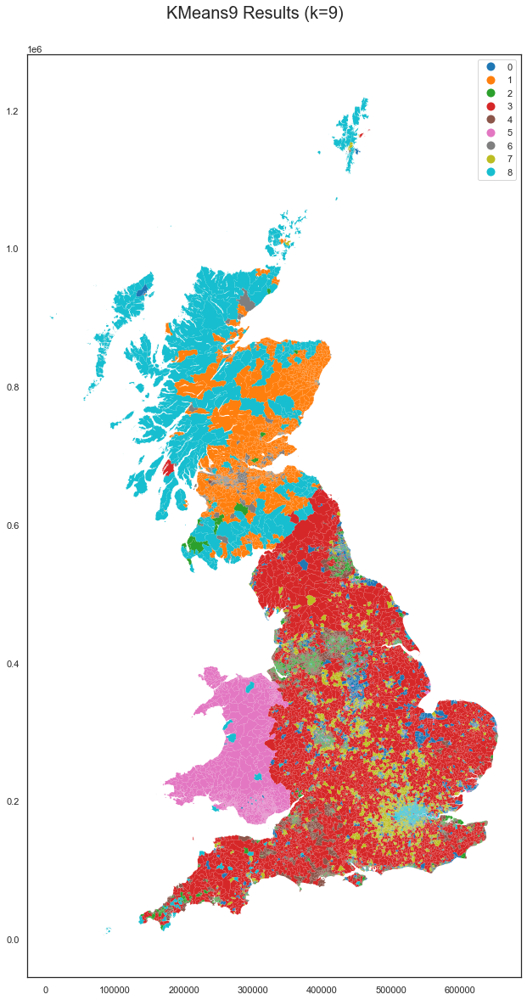

In [104]:
fig, ax = plt.subplots(figsize=(25,20))
fig.suptitle(f"{c_nm9} Results (k={k_pref})", fontsize=20, y=0.92)
results_past_gdf.plot(column=c_nm9, ax=ax, linewidth=0, zorder=0, categorical=True, legend=True);

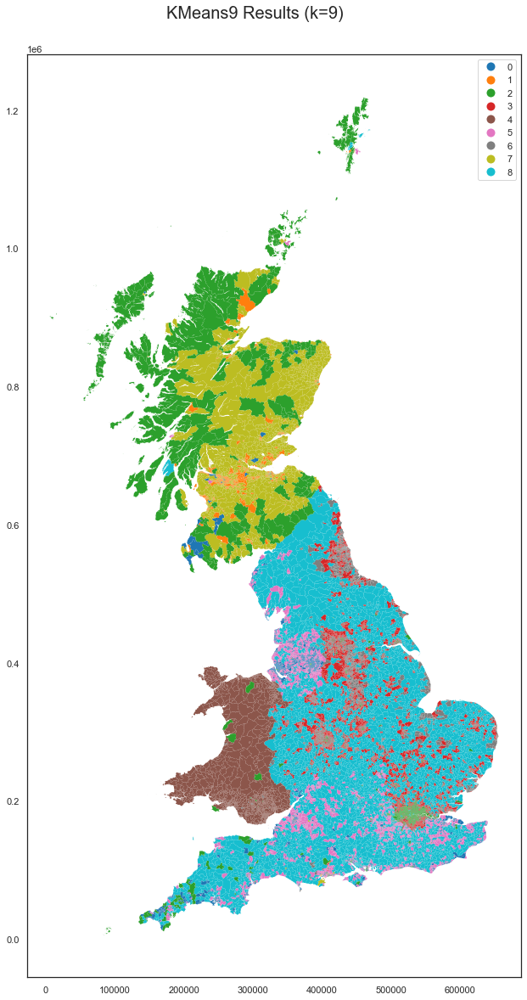

In [83]:
fig, ax = plt.subplots(figsize=(25,20))
fig.suptitle(f"{c_nm9} Results (k={k_pref})", fontsize=20, y=0.92)
results_future_gdf.plot(column=c_nm9, ax=ax, linewidth=0, zorder=0, categorical=True, legend=True);

In [84]:
# https://datatofish.com/numpy-array-to-pandas-dataframe/
# convert the array to a dataframe

nine_clusters_past = pd.DataFrame(centers9_past, columns = gdf_vars_past41.columns, index = ['Cluster 1 Center','Cluster 2 Center','Cluster 3 Center', 'Cluster 4 Center', 'Cluster 5 Center', 'Cluster 6 Center', 'Cluster 7 Center', 'Cluster 8 Centre', 'Cluster 9 Centre'])
nine_clusters_past.head()

,Total Past Spending,AHAH,GVA,Poor Health Indicator,Poor Living Environment Indicator,Poor Access to Amenities Indicator,Employment Domain numerator,Income Domain numerator,Proportion of Students not in School Post-16
Cluster 1 Center,-0.75,-0.34,0.60,0.42,-0.29,0.28,0.20,0.19,-0.16
Cluster 2 Center,1.01,-0.51,-0.86,-1.14,-0.31,-1.31,-0.71,-0.77,1.63
Cluster 3 Center,0.42,-0.16,-0.45,1.18,0.30,-0.07,0.89,0.87,-0.11
Cluster 4 Center,-0.32,1.20,0.55,-0.44,-0.73,1.69,-0.86,-0.82,-0.46
Cluster 5 Center,0.61,-0.26,-0.55,-0.03,-0.66,0.40,-0.69,-0.76,-0.63


In [85]:
# https://datatofish.com/numpy-array-to-pandas-dataframe/
# convert the array to a dataframe

nine_clusters_future = pd.DataFrame(centers9_future, columns = gdf_vars_future41.columns, index = ['Cluster 1 Center','Cluster 2 Center','Cluster 3 Center', 'Cluster 4 Center', 'Cluster 5 Center', 'Cluster 6 Center', 'Cluster 7 Center', 'Cluster 8 Centre', 'Cluster 9 Centre'])
nine_clusters_future.head()

,Total Future Spending,AHAH,GVA,Poor Health Indicator,Poor Living Environment Indicator,Poor Access to Amenities Indicator,Employment Domain numerator,Income Domain numerator,Staying on in education post 16 indicator
Cluster 1 Center,1.01,-0.19,-0.01,1.06,0.32,-0.02,0.68,0.65,-0.15
Cluster 2 Center,1.13,-1.02,-1.04,0.68,0.82,-1.58,1.03,1.01,1.44
Cluster 3 Center,-0.30,1.11,0.37,-0.72,1.16,-0.37,0.09,0.19,-0.22
Cluster 4 Center,-0.94,-0.09,0.09,-0.50,-0.83,0.43,-0.87,-0.90,-0.67
Cluster 5 Center,-1.03,0.01,-0.03,0.72,1.24,-0.30,1.64,1.65,0.67


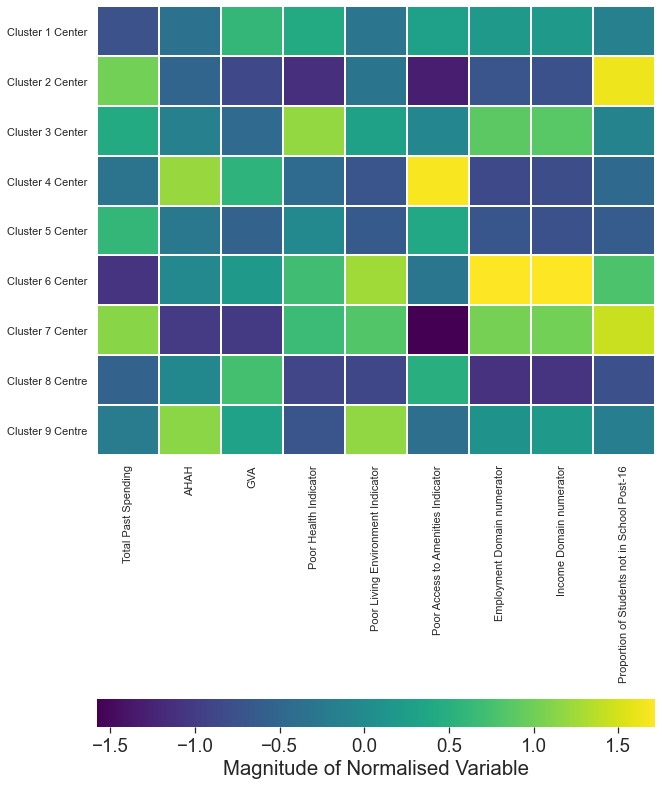

In [86]:
#normalised_national.set_index('Cluster', inplace = True)

fig, ax = plt.subplots(figsize=(10, 15))
sns.set(font_scale=1.7)
sns.set_style("whitegrid")
ax = sns.heatmap(nine_clusters_past, cmap = "viridis",
           linewidth=0.3,
           cbar_kws={'label': 'Magnitude of Normalised Variable',
                    'orientation':'horizontal',
                    'pad':0.3})


#plt.savefig('National-Clusters-Heatmap.png',bbox_inches='tight')

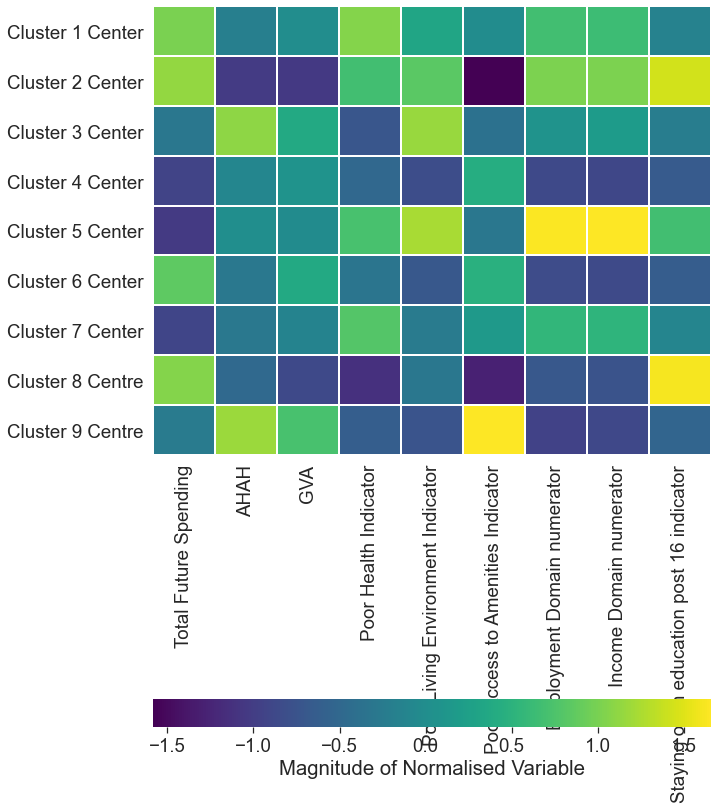

In [87]:
#normalised_national.set_index('Cluster', inplace = True)

fig, ax = plt.subplots(figsize=(10, 15))
sns.set(font_scale=1.7)
sns.set_style("whitegrid")
ax = sns.heatmap(nine_clusters_future, cmap = "viridis",
           linewidth=0.3,
           cbar_kws={'label': 'Magnitude of Normalised Variable',
                    'orientation':'horizontal',
                    'pad':0.3})


#plt.savefig('National-Clusters-Heatmap.png',bbox_inches='tight')

## Third K-Means Clustering
#### Let's see what  8 clusters look like

In [105]:
c_nm12   = 'KMeans8' # Clustering name
k_pref = 8 # Number of clusters

kmeans8_past = KMeans(n_clusters=k_pref, n_init=25, random_state=42).fit(gdf_vars_past41) # The process

print(kmeans8_past.labels_)


[3 6 6 ... 2 2 4]


In [106]:
c_nm8   = 'KMeans8' # Clustering name
k_pref = 8 # Number of clusters

kmeans8_future = KMeans(n_clusters=k_pref, n_init=25, random_state=42).fit(gdf_vars_future41) # The process

print(kmeans8_future.labels_)


[1 1 1 ... 6 6 0]


Capture the cluster centers for our table:

In [107]:
centers8_past = kmeans8_past.cluster_centers_
print(centers8_past)

[[-1.07149642 -0.03236563  0.20434485  0.71846476  1.194506   -0.27446436
   1.67485205  1.67570151  0.74537771]
 [ 0.54804802 -0.21430907 -0.50280836 -0.09961223 -0.68493365  0.46375625
  -0.75457808 -0.80562546 -0.64615739]
 [ 1.12896885 -1.00523617 -1.02149864  0.6760362   0.83025955 -1.57799787
   1.02778685  1.0171535   1.43739436]
 [-0.50257709  0.47463196  0.74665419 -0.80911546 -0.86212248  0.98305126
  -1.06987896 -1.03991913 -0.68098947]
 [ 1.00888548 -0.51924119 -0.85854597 -1.13573886 -0.30660751 -1.30757653
  -0.70964044 -0.76434533  1.63104329]
 [-0.75645667 -0.28102135  0.64444447  0.33076676 -0.35226489  0.31702935
   0.08836518  0.07641007 -0.19914399]
 [-0.21510742  1.13932116  0.3046478  -0.70018342  1.16174295 -0.3729914
   0.09669245  0.19373674 -0.1923984 ]
 [ 0.40475254 -0.1906971  -0.4350146   1.15682181  0.26019606 -0.05035894
   0.85700001  0.83393311 -0.11756065]]


In [108]:
centers8_future = kmeans8_future.cluster_centers_
print(centers8_future)

[[ 1.05361647 -0.49201082 -0.87548154 -1.11602283 -0.29013257 -1.26900967
  -0.7050853  -0.7582402   1.59253706]
 [-0.2881887   1.11811766  0.3569367  -0.72739507  1.14709354 -0.35218264
   0.06253981  0.16334469 -0.22685081]
 [ 1.00831768 -0.23078476  0.01867163  0.99196851  0.26621537 -0.00192922
   0.60416087  0.5665022  -0.17679154]
 [ 0.78231191  0.07204116  0.50246903 -0.45564266 -0.73080892  0.78164953
  -0.93027638 -0.91952275 -0.64439119]
 [-0.97389362  0.25772862  0.25590423 -0.5460829  -0.86684711  0.76273848
  -0.89401899 -0.90803329 -0.6459972 ]
 [-0.90990404 -0.30833735 -0.14073645  0.71719409 -0.28642266  0.17250287
   0.45057944  0.42990134 -0.13928641]
 [ 1.13417784 -1.01496209 -1.03629385  0.68650855  0.82389495 -1.57854142
   1.03095196  1.01944779  1.44223729]
 [-0.99440574  0.0119167  -0.04539042  0.7563958   1.18638265 -0.28857634
   1.60529142  1.61591363  0.63453646]]


Now capture the labels (i.e. clusters) and write them to a data series that we store on the result set df (`rs`):

In [109]:
# Add it to the data frame
results_past[c_nm8] = pd.Series(kmeans8_past.labels_, index=gdf_vars_past41.index)
results_future[c_nm8] = pd.Series(kmeans8_future.labels_, index=gdf_vars_future41.index)

In [110]:
# Add it to the geodata frame
results_past_gdf[c_nm8] = pd.Series(kmeans8_past.labels_, index=gdf_vars_past41.index)
results_future_gdf[c_nm8] = pd.Series(kmeans8_future.labels_, index=gdf_vars_future41.index)

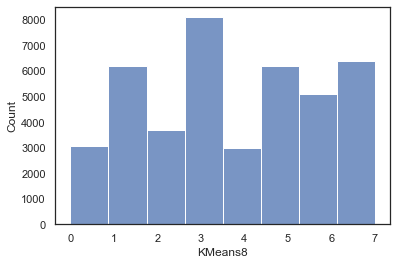

In [111]:
# How are the clusters distributed?
ax = sns.histplot(data=results_past, x=c_nm8, bins=k_pref);
plt.savefig('ExportedFigures/KMeans8HistPast.png',bbox_inches='tight')

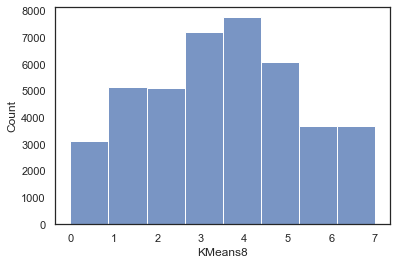

In [112]:
# How are the clusters distributed?
ax = sns.histplot(data=results_future, x=c_nm8, bins=k_pref);
plt.savefig('ExportedFigures/KMeans8HistFuture.png',bbox_inches='tight')

In [113]:
# There are 'only' 11 variables to plot so we'll plot them all against each other plot every variable against every
#sns.pairplot(results_past, 
#             vars=cols_to_plot, 
#             hue=c_nm12, markers=".", height=3, diag_kind='kde');

In [114]:
#sns.set(style="white")
#sns.pairplot(results_future, 
#             vars=cols_to_plot_future, 
#             hue=c_nm7, markers=".", height=3, diag_kind='kde');

In [115]:
results_past_gdf['KMeans8'].describe()

count   41,729.00
mean         3.74
std          2.24
min          0.00
25%          2.00
50%          3.00
75%          6.00
max          7.00
Name: KMeans8, dtype: float64

In [116]:
results_past_gdf['K-Means Cluster Number'] = results_past_gdf['KMeans8'] + 1
results_future_gdf['K-Means Cluster Number'] = results_future_gdf['KMeans8'] + 1

And here's a map!

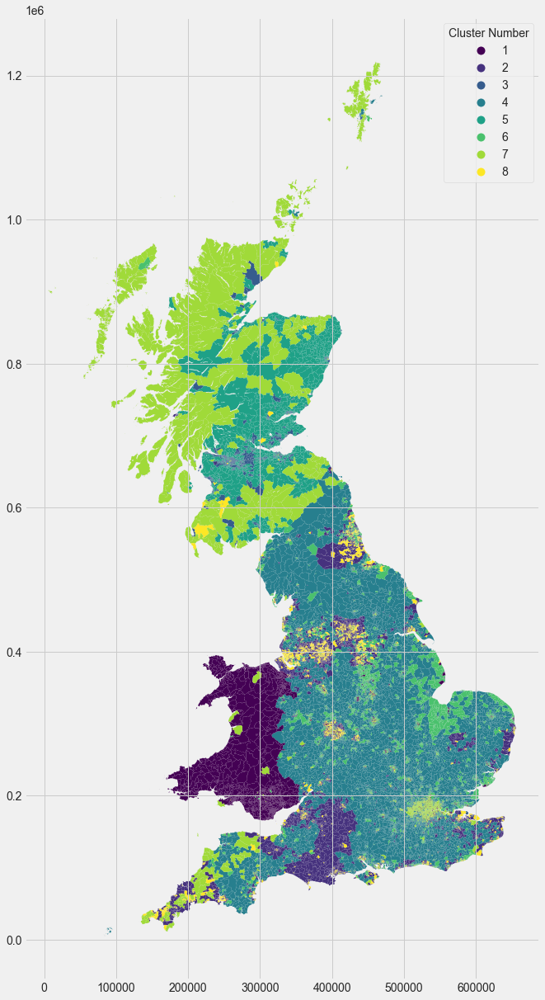

In [111]:
color_map = plt.cm.get_cmap('viridis')
fig, ax = plt.subplots(figsize=(25,20))

results_past_gdf.plot(ax = ax, column='K-Means Cluster Number', cmap = color_map, linewidth=0, zorder=0, categorical=True, legend=True);
leg=ax.get_legend()
leg.set(title='Cluster Number')

plt.savefig('ExportedFigures/KMeans8MapPast.png',bbox_inches='tight')

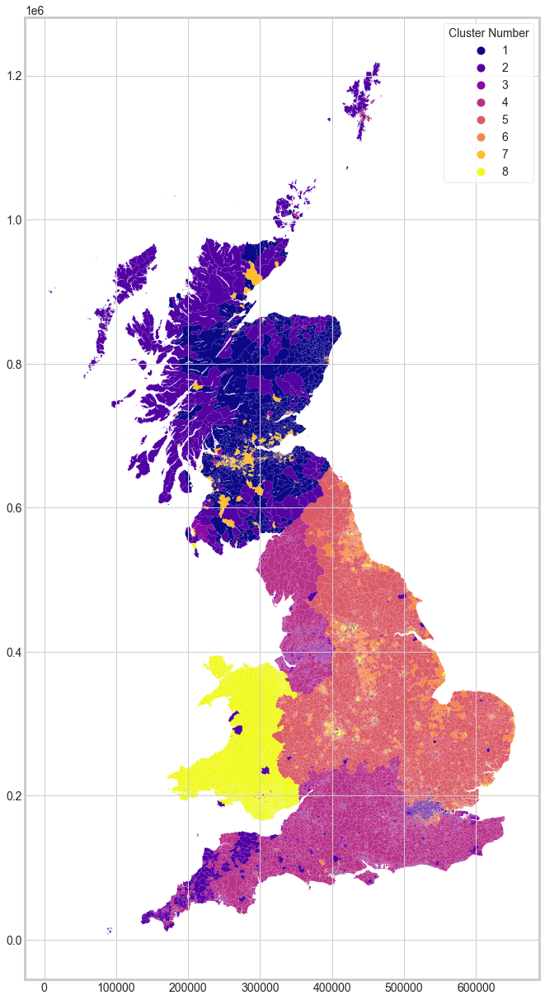

In [112]:
sns.set_style("whitegrid")
color_map = plt.cm.get_cmap('plasma')
fig, ax = plt.subplots(figsize=(25,20))

results_future_gdf.plot(column='K-Means Cluster Number' , cmap = color_map, ax=ax, linewidth=0, zorder=0, categorical=True, legend=True);
leg=ax.get_legend()
leg.set(title='Cluster Number')


plt.savefig('ExportedFigures/KMeans8MapFuture.png',bbox_inches='tight')

In [120]:
# https://datatofish.com/numpy-array-to-pandas-dataframe/
# convert the array to a dataframe

eight_clusters_past = pd.DataFrame(centers8_past, columns = gdf_vars_past41.columns, index = ['Cluster 1 Center','Cluster 2 Center','Cluster 3 Center', 
                                                                                               'Cluster 4 Center', 'Cluster 5 Center', 'Cluster 6 Center', 
                                                                                               'Cluster 7 Center', 'Cluster 8 Center'])
eight_clusters_past.head()
eight_clusters_past.to_csv('ExportedData/PastClusterCentres8.csv')

In [121]:
# https://datatofish.com/numpy-array-to-pandas-dataframe/
# convert the array to a dataframe

eight_clusters_future = pd.DataFrame(centers8_future, columns = gdf_vars_future41.columns, index = ['Cluster 1 Center','Cluster 2 Center','Cluster 3 Center', 
                                                                                               'Cluster 4 Center', 'Cluster 5 Center', 'Cluster 6 Center', 
                                                                                               'Cluster 7 Center', 'Cluster 8 Center'])
eight_clusters_future.head()
eight_clusters_future.to_csv('ExportedData/FutureClusterCentres8.csv')

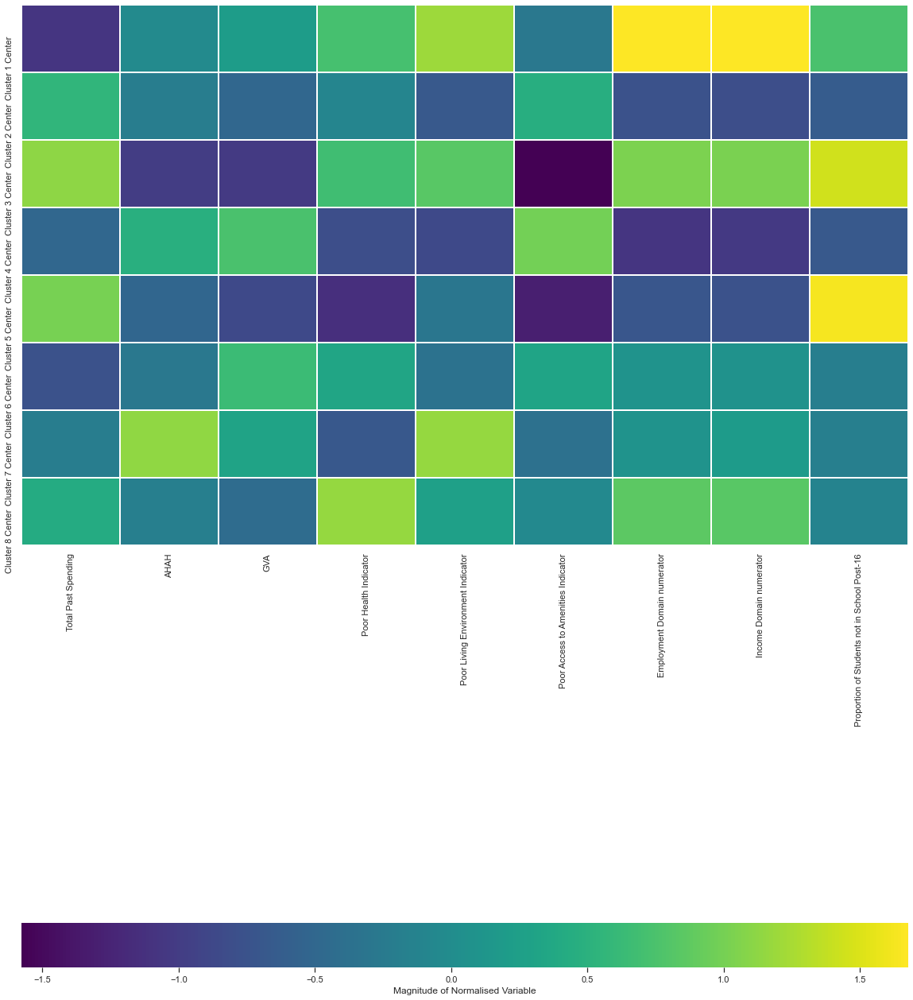

In [122]:
#normalised_national.set_index('Cluster', inplace = True)

fig, ax = plt.subplots(figsize=(20, 25))
#sns.set(font_scale=2)
sns.set_style("whitegrid")
ax = sns.heatmap(eight_clusters_past, cmap = "viridis",
           linewidth=0.3,
           cbar_kws={'label': 'Magnitude of Normalised Variable',
                    'orientation':'horizontal',
                    'pad':0.35})

plt.savefig('ExportedFigures/PastClustersHeatmap.png',bbox_inches='tight')


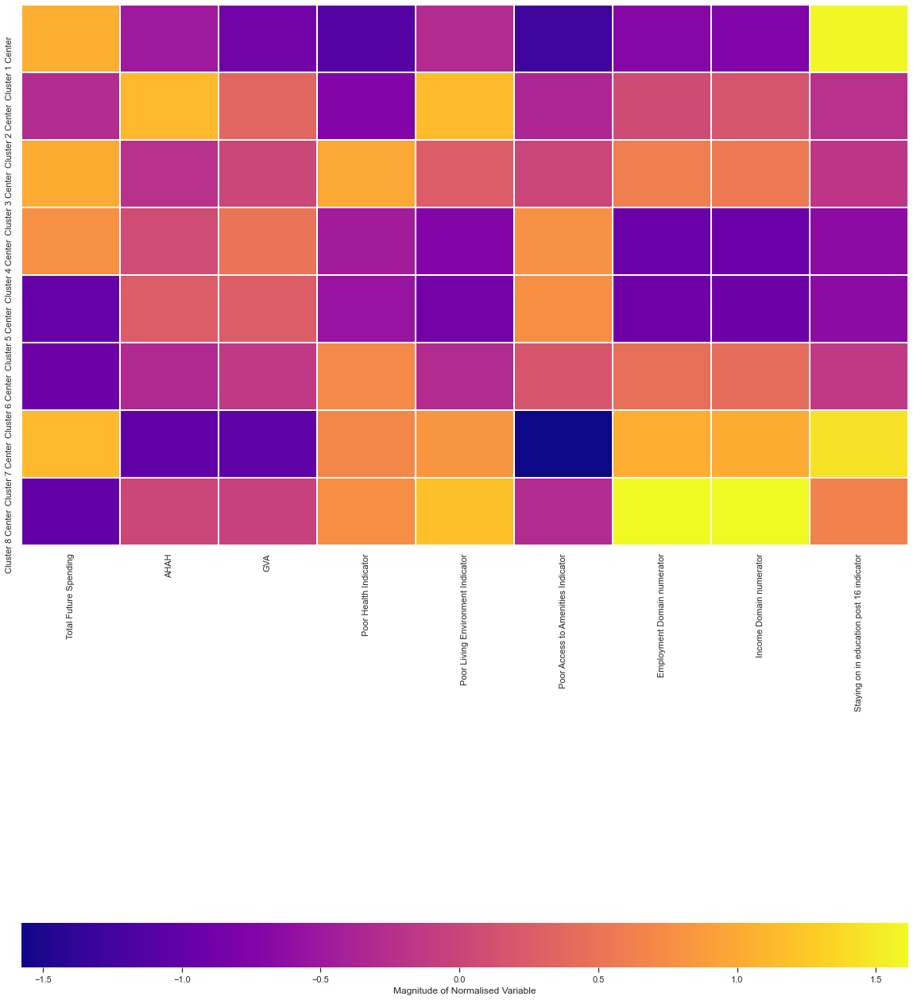

In [123]:
#normalised_national.set_index('Cluster', inplace = True)

fig, ax = plt.subplots(figsize=(20, 25))
#sns.set(font_scale=1.7)
sns.set_style("whitegrid")
ax = sns.heatmap(eight_clusters_future, cmap = "plasma",
           linewidth=0.3,
           cbar_kws={'label': 'Magnitude of Normalised Variable',
                    'orientation':'horizontal',
                    'pad':0.35})


plt.savefig('ExportedFigures/FutureClustersHeatmap.png',bbox_inches='tight')
#plt.savefig('National-Clusters-Heatmap.png',bbox_inches='tight')

## PCA ANALYSIS

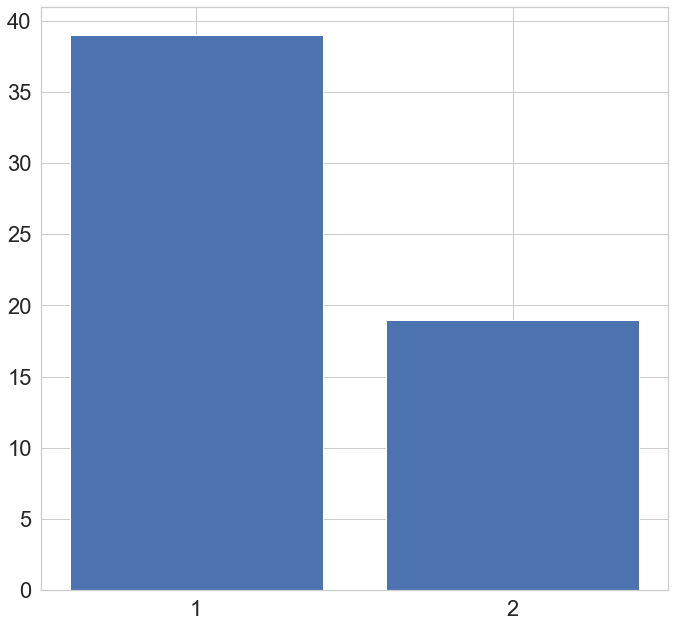

In [117]:
pca = PCA(2)

#making a copy of each df

gdf_vars_pastpca = gdf_vars_past41.copy()
gdf_vars_futurepca = gdf_vars_future41.copy()

#convert 
gdf_vars_pastpca = pca.fit_transform(gdf_vars_pastpca)
gdf_vars_futurepca = pca.fit_transform(gdf_vars_futurepca)


#plot the PCA and check variance of components

plt.figure(figsize=(10,10))
var = np.round(pca.explained_variance_ratio_*100, decimals = 1)
lbls = [str(x) for x in range(1,len(var)+1)]
plt.bar(x=range(1,len(var)+1), height = var, tick_label = lbls)
plt.show()

In [118]:
c_nm8_pca   = 'Cluster Number' # Clustering name
k_pref = 8 # Number of clusters

kmeans8_past_pca = KMeans(n_clusters=k_pref, n_init=25, random_state=42).fit(gdf_vars_pastpca) # The process

print(kmeans8_past_pca.labels_)

[0 0 7 ... 5 5 6]


In [119]:
c_nm8_pca   = 'Cluster Number' # Clustering name
k_pref = 8 # Number of clusters

kmeans8_future_pca = KMeans(n_clusters=k_pref, n_init=25, random_state=42).fit(gdf_vars_futurepca) # The process

print(kmeans8_future_pca.labels_)

[5 5 3 ... 7 7 0]


In [120]:
centers8_past_pca = kmeans8_past_pca.cluster_centers_
centers8_future_pca = kmeans8_future_pca.cluster_centers_

In [121]:
# Add it to the data frame
results_past[c_nm8_pca] = pd.Series(kmeans8_past_pca.labels_, index=gdf_vars_past41.index)
results_future[c_nm8_pca] = pd.Series(kmeans8_future_pca.labels_, index=gdf_vars_future41.index)

In [122]:
# Add it to the geodata frame
results_past_gdf[c_nm8_pca] = pd.Series(kmeans8_past_pca.labels_, index=gdf_vars_past41.index)
results_future_gdf[c_nm8_pca] = pd.Series(kmeans8_future_pca.labels_, index=gdf_vars_future41.index)

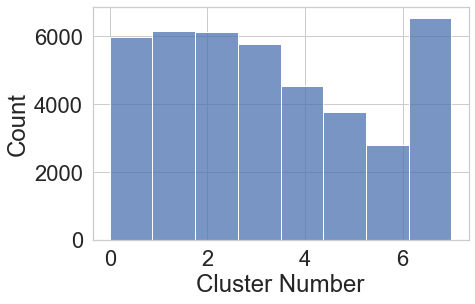

In [123]:
# How are the clusters distributed?
ax = sns.histplot(data=results_past, x=c_nm8_pca, bins=k_pref);
#plt.savefig('ExportedFigures/KMeans12HistPast.png',bbox_inches='tight')


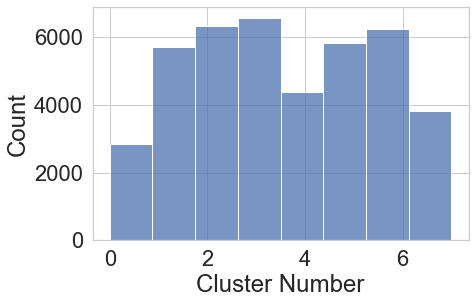

In [124]:

# How are the clusters distributed?
ax = sns.histplot(data=results_future, x=c_nm8_pca, bins=k_pref);
#plt.savefig('ExportedFigures/KMeans12HistFuture.png',bbox_inches='tight')

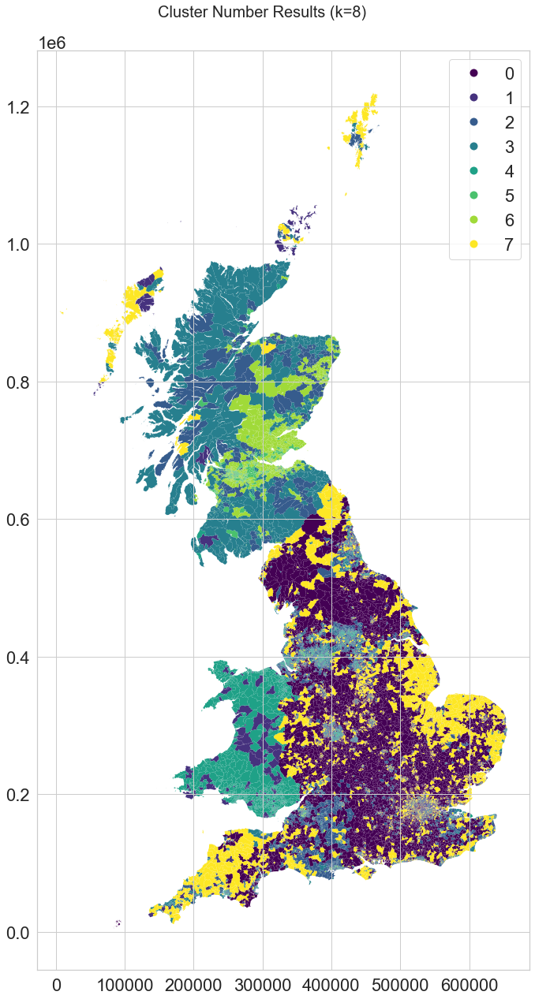

In [125]:
#mapping the clusters
color_map = plt.cm.get_cmap('viridis')
fig, ax = plt.subplots(figsize=(25,20))
fig.suptitle(f"{c_nm8_pca} Results (k={k_pref})", fontsize=20, y=0.92)
results_past_gdf.plot(column=c_nm8_pca, cmap = color_map, ax=ax, linewidth=0, zorder=0, categorical=True, legend=True);
plt.savefig('ExportedFigures/KMeans8MapPastPCA.png',bbox_inches='tight')

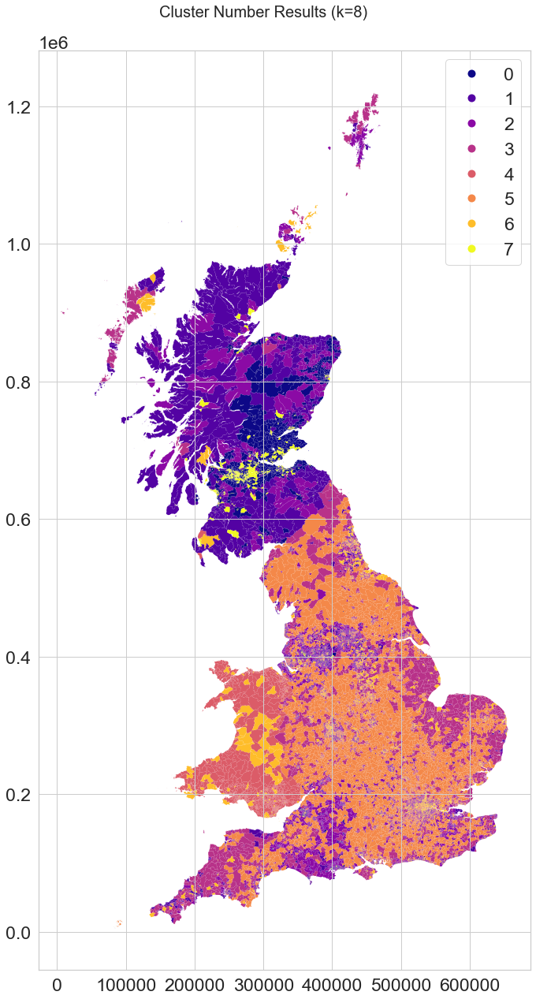

In [150]:
#mapping the clusters
color_map = plt.cm.get_cmap('plasma')
fig, ax = plt.subplots(figsize=(25,20))
fig.suptitle(f"{c_nm8_pca} Results (k={k_pref})", fontsize=20, y=0.92)
results_future_gdf.plot(column=c_nm8_pca, cmap = color_map, ax=ax, linewidth=0, zorder=0, categorical=True, legend=True);
plt.savefig('ExportedFigures/KMeans8MapFuturePCA.png',bbox_inches='tight')

In [127]:
# https://datatofish.com/numpy-array-to-pandas-dataframe/
# convert the array to a dataframe

gdf_vars_pastpca_df = pd.DataFrame(data=gdf_vars_pastpca, columns=["dimension1", "dimension2"])

eight_clusters_past_pca = pd.DataFrame(centers8_past_pca, columns = gdf_vars_pastpca_df.columns, index = ['Cluster 1 Center','Cluster 2 Center','Cluster 3 Center', 
                                                                                               'Cluster 4 Center', 'Cluster 5 Center', 'Cluster 6 Center', 
                                                                                               'Cluster 7 Center', 'Cluster 8 Center'])
eight_clusters_past_pca.head()

#### Get the national average of all msoas for each column from gdf_vars12 - yeo-johnson power transformed
#### Then add it as the first column of the clusters df

#av_gdf_vars41_column = gdf_vars_past41.mean(axis=0)
#av_gdf_vars41_column


,dimension1,dimension2
Cluster 1 Center,-2.69,-0.39
Cluster 2 Center,0.87,-1.24
Cluster 3 Center,-1.52,0.83
Cluster 4 Center,0.55,0.31
Cluster 5 Center,2.51,-1.14


In [128]:
# https://datatofish.com/numpy-array-to-pandas-dataframe/
# convert the array to a dataframe

gdf_vars_futurepca_df = pd.DataFrame(data=gdf_vars_futurepca, columns=["dimension1", "dimension2"])

eight_clusters_future_pca = pd.DataFrame(centers8_future_pca, columns = gdf_vars_pastpca_df.columns, index = ['Cluster 1 Center','Cluster 2 Center','Cluster 3 Center', 
                                                                                               'Cluster 4 Center', 'Cluster 5 Center', 'Cluster 6 Center', 
                                                                                               'Cluster 7 Center', 'Cluster 8 Center'])
eight_clusters_future_pca

#### Get the national average of all msoas for each column from gdf_vars12 - yeo-johnson power transformed
#### Then add it as the first column of the clusters df

#av_gdf_vars41_column = gdf_vars_past41.mean(axis=0)
#av_gdf_vars41_column


,dimension1,dimension2
Cluster 1 Center,0.06,2.84
Cluster 2 Center,0.50,0.30
Cluster 3 Center,-1.58,0.77
Cluster 4 Center,-0.85,-0.78
Cluster 5 Center,2.55,-1.15
Cluster 6 Center,-2.68,-0.44
Cluster 7 Center,0.93,-1.23
Cluster 8 Center,2.94,1.48


In [129]:
results_future_gdf_temporary = results_future_gdf.reset_index()
results_future_gdf_temporary = results_future_gdf_temporary[['Cluster Number', 'Code', 'geometry']]

results_past_gdf_temporary = results_past_gdf.reset_index()
results_past_gdf_temporary = results_past_gdf_temporary[['Cluster Number', 'Code', 'geometry']]

gdf_results_PCAplot_past = results_past_gdf_temporary.join(gdf_vars_pastpca_df)
gdf_results_PCAplot_future = results_future_gdf_temporary.join(gdf_vars_futurepca_df)

In [130]:
gdf_results_PCAplot_past['Cluster Number'] = gdf_results_PCAplot_past['Cluster Number'] + 1
gdf_results_PCAplot_future['Cluster Number'] = gdf_results_PCAplot_future['Cluster Number'] + 1

AttributeError: 'function' object has no attribute 'set'

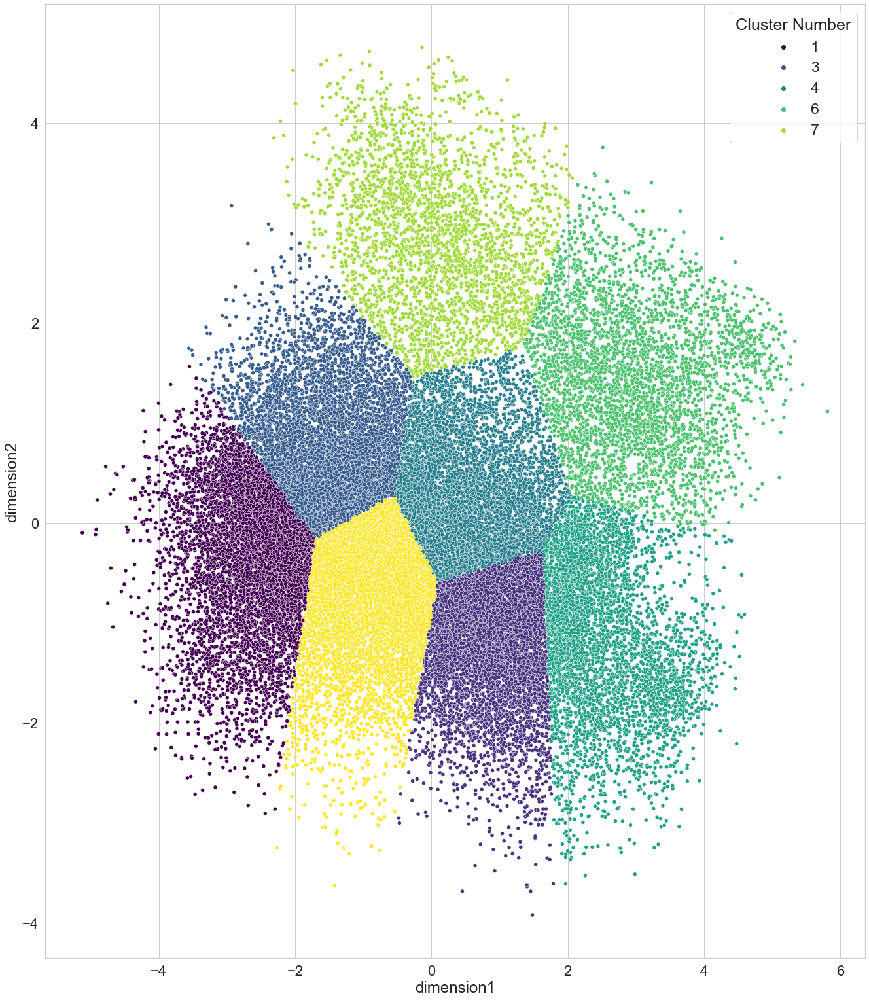

In [131]:

fig, ax = plt.subplots(figsize=(20, 25))
sns.set(font_scale=2.1)
sns.set_style("whitegrid")
g = sns.scatterplot(data=gdf_results_PCAplot_past, x="dimension1", y="dimension2", hue="Cluster Number", palette = "viridis", )

legend = g.legend

legend.set.title("test")
for t, l in zip(legend.texts,("1", "2", "3" ,"4", "5", "6","7", "8")):
    t.set.text(1)




#
#sns.set_style("whitegrid")
#color_map = plt.cm.get_cmap('plasma')
#fig, ax = plt.subplots(figsize=(25,20))

#results_future_gdf.plot(column='K-Means Cluster Number' , cmap = color_map, ax=ax, linewidth=0, zorder=0, categorical=True, legend=True);
#leg=ax.get_legend()
#leg.set(title='Cluster Number')


#plt.savefig('ExportedFigures/PCAClustersPlotPast.png',bbox_inches='tight')

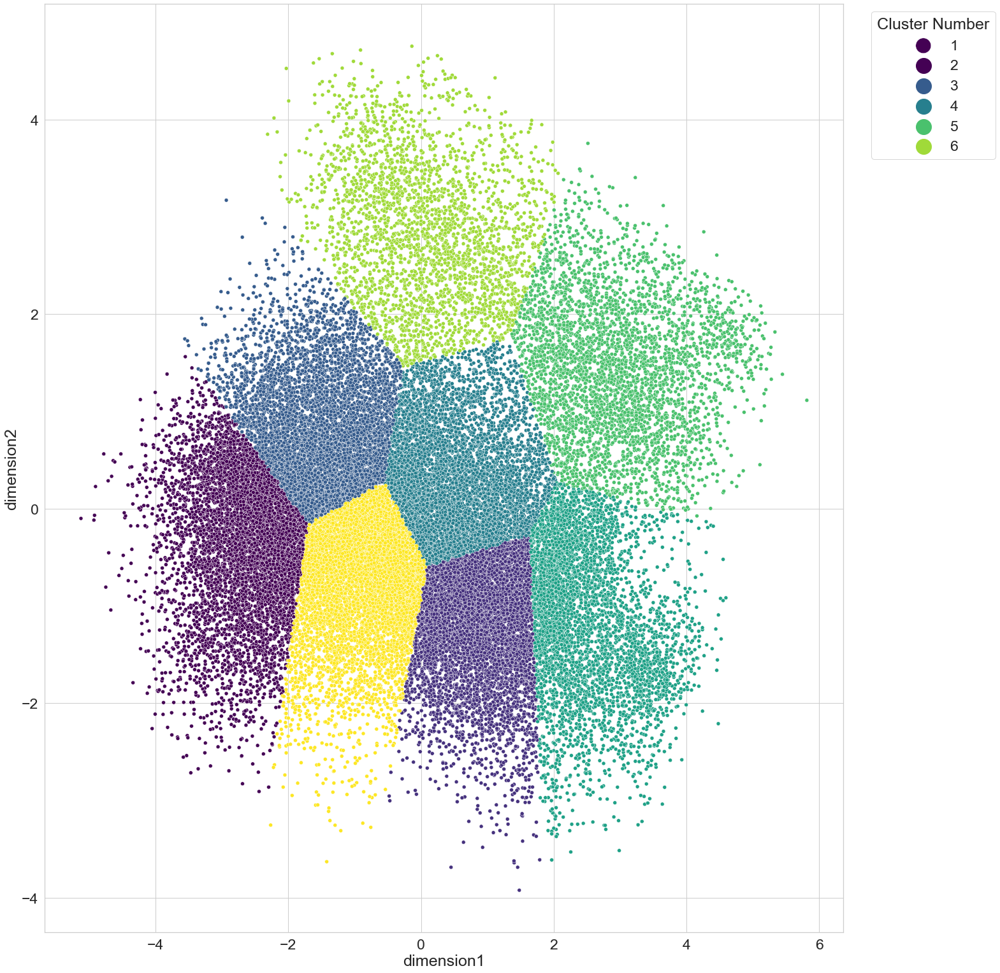

In [133]:
no_clusters = ['1', '2', '3' ,'4', '5', '6','7', '8']

fig, ax = plt.subplots(figsize=(20, 25))
sns.set(font_scale=2.1)
sns.set_style("whitegrid")
g = sns.scatterplot(data=gdf_results_PCAplot_past, x="dimension1", y="dimension2", hue="Cluster Number", palette = "viridis")

plt.legend(no_clusters, title = 'Cluster Number', markerscale = 4, bbox_to_anchor= (1.2,1))

plt.savefig('ExportedFigures/PCAClustersPlotPast.png',bbox_inches='tight')

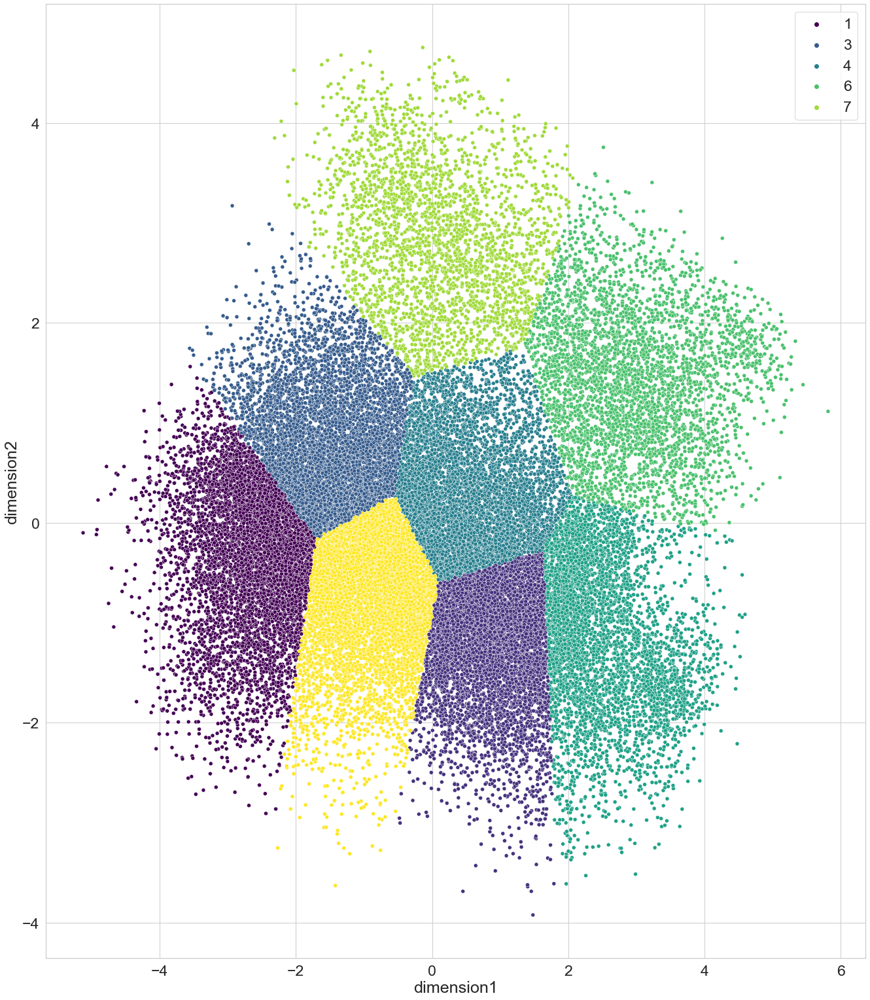

In [134]:
no_clusters = ['1', '2', '3' ,'4', '5', '6','7', '8']

fig, ax = plt.subplots(figsize=(20, 25))
sns.set(font_scale=2.1)
sns.set_style("whitegrid")
g = sns.scatterplot(data=gdf_results_PCAplot_past, x="dimension1", y="dimension2", hue="Cluster Number", palette = "viridis")

plt.legend()

plt.savefig('ExportedFigures/PCAClustersPlotPast.png',bbox_inches='tight')

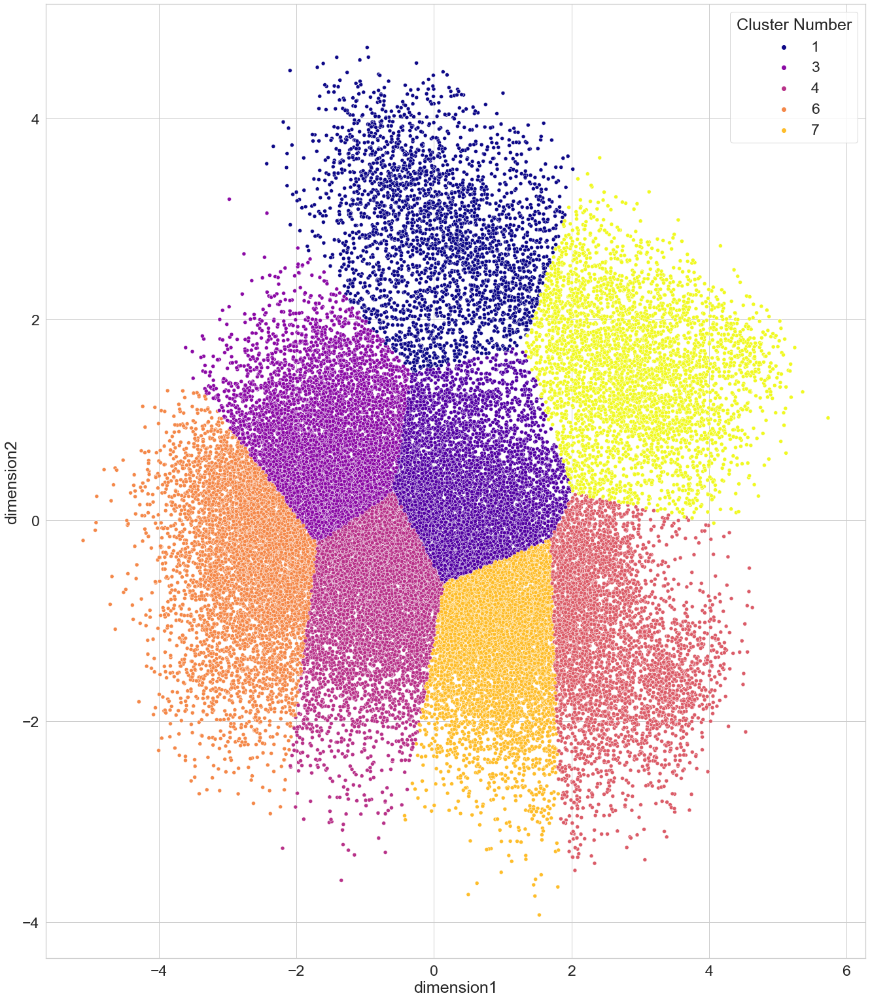

In [135]:
fig, ax = plt.subplots(figsize=(20, 25))
sns.set(font_scale=2.1)
sns.set_style("whitegrid")
ax = sns.scatterplot(data=gdf_results_PCAplot_future, x="dimension1", y="dimension2", hue="Cluster Number", palette = "plasma")
#plt.setp(ax.get_legend().get_texts(), fontsize='16') # for legend text
#plt.setp(ax.get_legend().get_title(), fontsize='16') # for legend title

plt.savefig('ExportedFigures/PCAClustersPlotFuture.png',bbox_inches='tight')

# Summaries and Area-Specific


In [124]:
NUTSLookups.drop(['NUTS1 Code', 'NUTS2 Code',  'NUTS3 Code', 'All Ages', 'Region Name', 
                  'Region Code', 'County Name', 'County Code' ,'LA Code (2019 boundaries)', 
                  'LA name (2019 boundaries)', 'LSOA Name'], axis = 1, inplace = True)

In [125]:
NUTSLookups.rename(columns = {'LSOA Code': 'Code'}, inplace = True)
NUTSLookups = NUTSLookups.set_index('Code')
results_past_gdf_summary =results_past_gdf.join(NUTSLookups, how = "left")
results_future_gdf_summary = results_future_gdf.join(NUTSLookups, how = "left")

In [127]:
results_past_gdf.head()

,Total Past Spending,AHAH,GVA,Poor Health Indicator,Poor Living Environment Indicator,Poor Access to Amenities Indicator,Employment Domain numerator,Income Domain numerator,Proportion of Students not in School Post-16,Name,Shape_Leng,Shape_Area,geometry,KMeans6,KMeans9,KMeans8,K-Means Cluster Number
Code,,,,,,,,,,,,,,,,,
E01000001,-0.45,2.62,3.62,-1.76,1.22,-0.11,-2.25,-2.02,-0.96,City of London 001A,"2,635.77","129,865.31","POLYGON ((532151.537 181867.433, 532152.500 18...",3,7,3,4
E01000002,-0.45,2.47,3.62,-1.54,1.10,-0.66,-1.73,-1.47,0.59,City of London 001B,"2,707.88","228,419.63","POLYGON ((532634.497 181926.016, 532632.048 18...",0,8,6,7
E01000003,-0.45,2.30,3.62,-0.25,1.88,-0.27,-0.32,-0.63,-0.08,City of London 001C,"1,224.64","59,054.35","POLYGON ((532153.703 182165.155, 532158.250 18...",0,8,6,7
E01000005,-0.45,2.39,3.62,-0.41,1.83,-0.78,0.11,0.27,0.54,City of London 001E,"2,275.81","189,577.71","POLYGON ((533619.062 181402.364, 533639.868 18...",0,8,6,7
E01000006,-0.88,1.68,0.17,-1.61,1.12,-0.14,-0.23,0.27,-1.43,Barking and Dagenham 016A,"1,966.09","146,537.00","POLYGON ((545126.852 184310.838, 545145.213 18...",0,8,6,7


<AxesSubplot:xlabel='K-Means Cluster Number', ylabel='NUTS1 Name'>

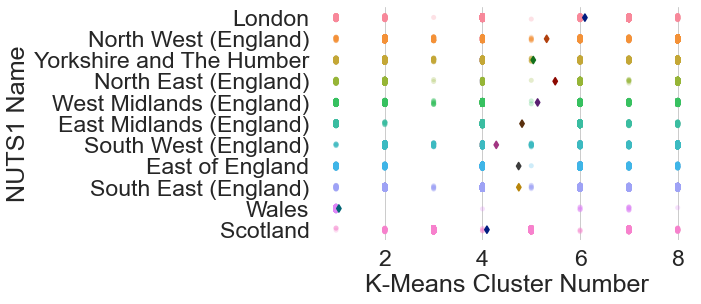

In [139]:
#subset the df to the data required
results_past_gdf_summary_stripplot = results_past_gdf_summary[['K-Means Cluster Number', 'NUTS1 Name']]
results_future_gdf_summary_stripplot = results_future_gdf_summary[['K-Means Cluster Number', 'NUTS1 Name']]

# "Melt" the dataset to "long-form" or "tidy" representation
#iris = pd.melt(iris, "species", var_name="measurement")

# Initialize the figure
f, ax = plt.subplots()
sns.despine(bottom=True, left=True)

# Show each observation with a scatterplot
sns.stripplot(x="K-Means Cluster Number", y="NUTS1 Name",
              data=results_past_gdf_summary_stripplot, dodge=True, alpha=.25, zorder=1)

# Show the conditional means, aligning each pointplot in the
# center of the strips by adjusting the width allotted to each
# category (.8 by default) by the number of hue levels
sns.pointplot(x="K-Means Cluster Number", y='NUTS1 Name',
              data=results_past_gdf_summary_stripplot,
              join=False, palette="dark",
              markers="d", scale=.75, ci=None)

# Improve the legend
#handles, labels = ax.get_legend_handles_labels()
#ax.legend(handles[3:], labels[3:], title="species",
#          handletextpad=0, columnspacing=1,
#          loc="lower right", ncol=3, frameon=True)

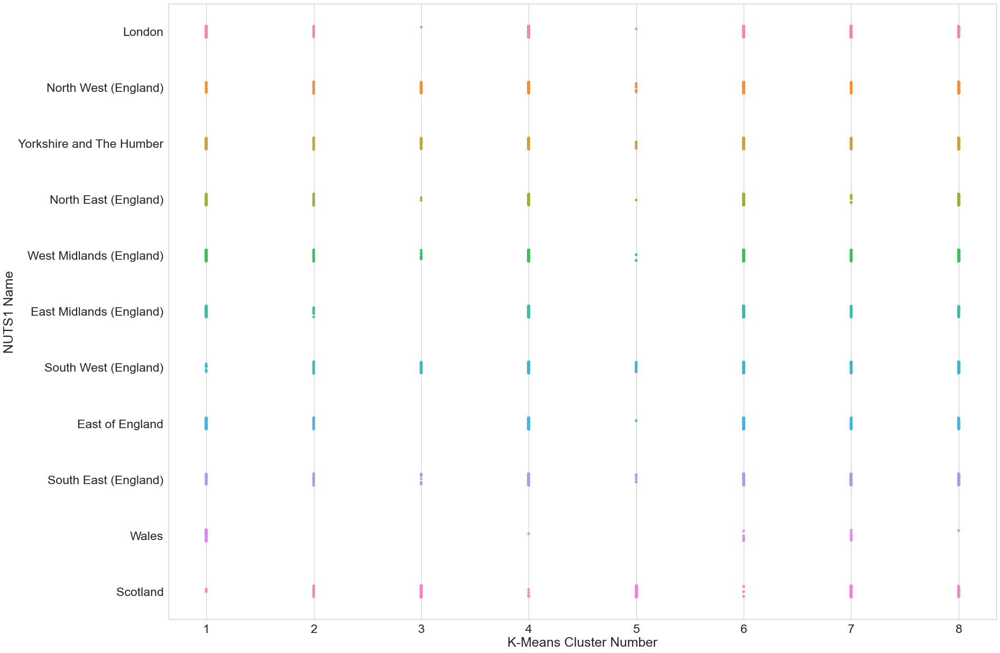

In [140]:
fig, ax = plt.subplots(figsize=(25,20))
ax = sns.stripplot(x="K-Means Cluster Number", y="NUTS1 Name", data=results_past_gdf_summary_stripplot)

In [141]:
results_past_gdf_summary_london = results_past_gdf_summary[results_past_gdf_summary['NUTS1 Name'] == "London"]

results_future_gdf_summary_london = results_future_gdf_summary[results_future_gdf_summary['NUTS1 Name'] == "London"]

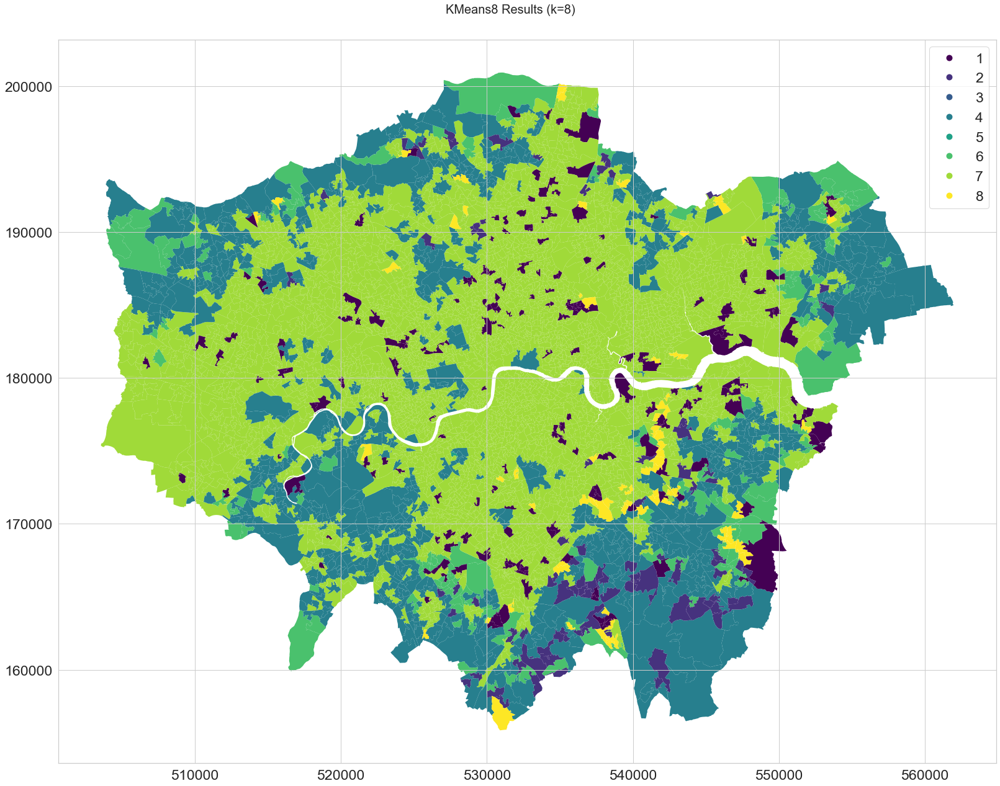

In [142]:
#mapping the clusters
color_map = plt.cm.get_cmap('viridis')
fig, ax = plt.subplots(figsize=(25,20))
fig.suptitle(f"{c_nm8} Results (k={k_pref})", fontsize=20, y=0.92)
results_past_gdf_summary_london.plot(column='K-Means Cluster Number', cmap = color_map, ax=ax, linewidth=0, zorder=0, categorical=True, legend=True);
plt.savefig('ExportedFigures/KMeans8MapLondonPast.png',bbox_inches='tight')

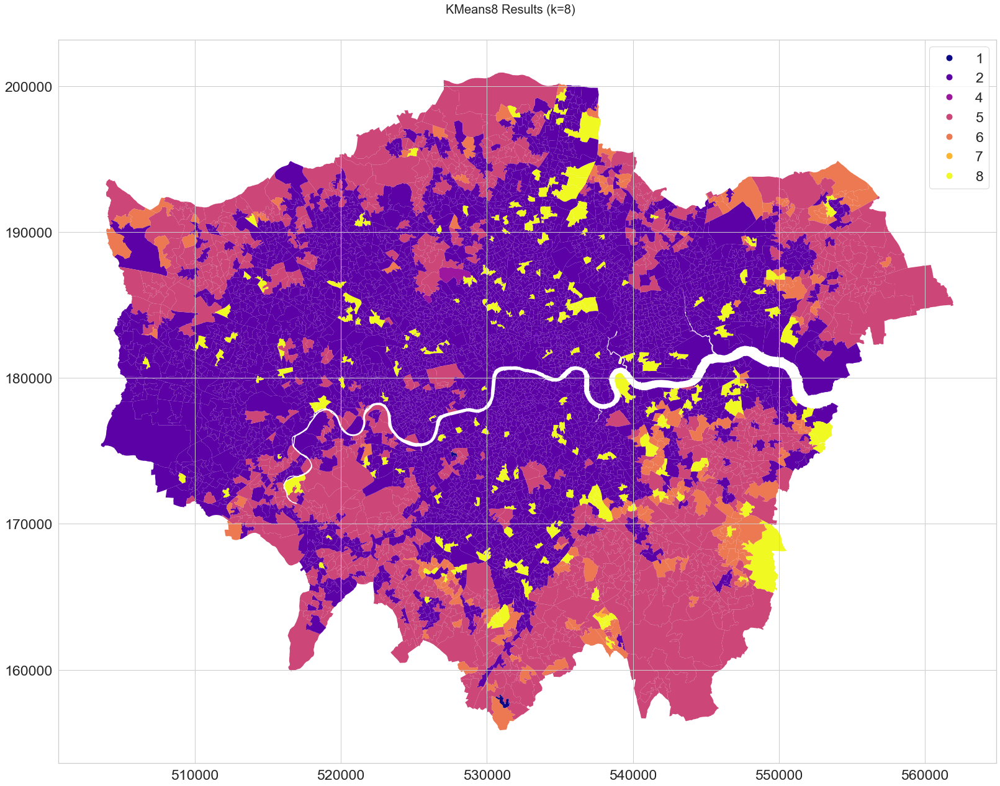

In [143]:
#mapping the clusters
color_map = plt.cm.get_cmap('plasma')
fig, ax = plt.subplots(figsize=(25,20))
fig.suptitle(f"{c_nm8} Results (k={k_pref})", fontsize=20, y=0.92)
results_future_gdf_summary_london.plot(column='K-Means Cluster Number', cmap = color_map, ax=ax, linewidth=0, zorder=0, categorical=True, legend=True);
plt.savefig('ExportedFigures/KMeans8MapLondonFuture.png',bbox_inches='tight')

In [144]:
list_northernregions = ["North East (England)", "North West (England)", "Yorkshire and The Humber", "West Midlands", "East Midlands"]
results_past_gdf_summary_north = results_past_gdf_summary[results_past_gdf_summary['NUTS1 Name'].isin(list_northernregions)]

results_future_gdf_summary_north = results_future_gdf_summary[results_future_gdf_summary['NUTS1 Name'].isin(list_northernregions)]

In [145]:
list_southernregions = ["South West (England)", "East of England", "South East (England)", "London"]
results_past_gdf_summary_south = results_past_gdf_summary[results_past_gdf_summary['NUTS1 Name'].isin(list_southernregions)]

results_future_gdf_summary_south = results_future_gdf_summary[results_future_gdf_summary['NUTS1 Name'].isin(list_southernregions)]

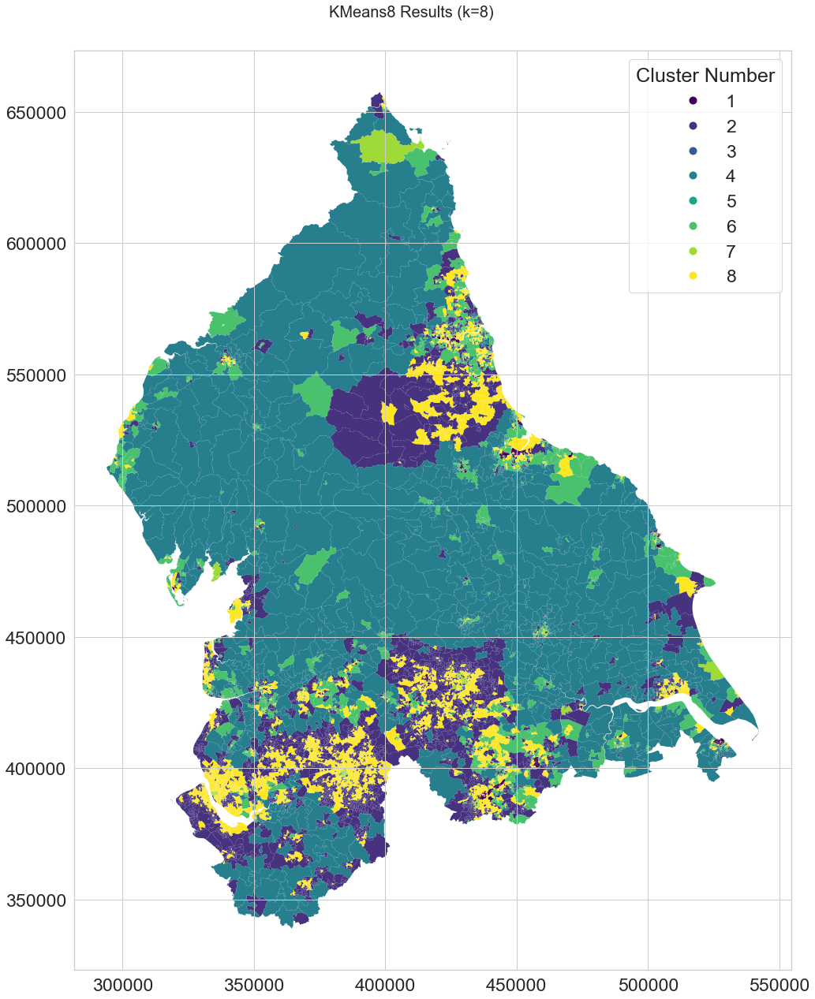

In [146]:
#mapping the clusters
color_map = plt.cm.get_cmap('viridis')
fig, ax = plt.subplots(figsize=(25,20))
fig.suptitle(f"{c_nm8} Results (k={k_pref})", fontsize=20, y=0.92)
results_past_gdf_summary_north.plot(column='K-Means Cluster Number', cmap = color_map, ax=ax, linewidth=0, zorder=0, categorical=True, legend=True);
leg=ax.get_legend()
leg.set(title='Cluster Number')
plt.savefig('ExportedFigures/KMeans8MapNorthPast.png',bbox_inches='tight')

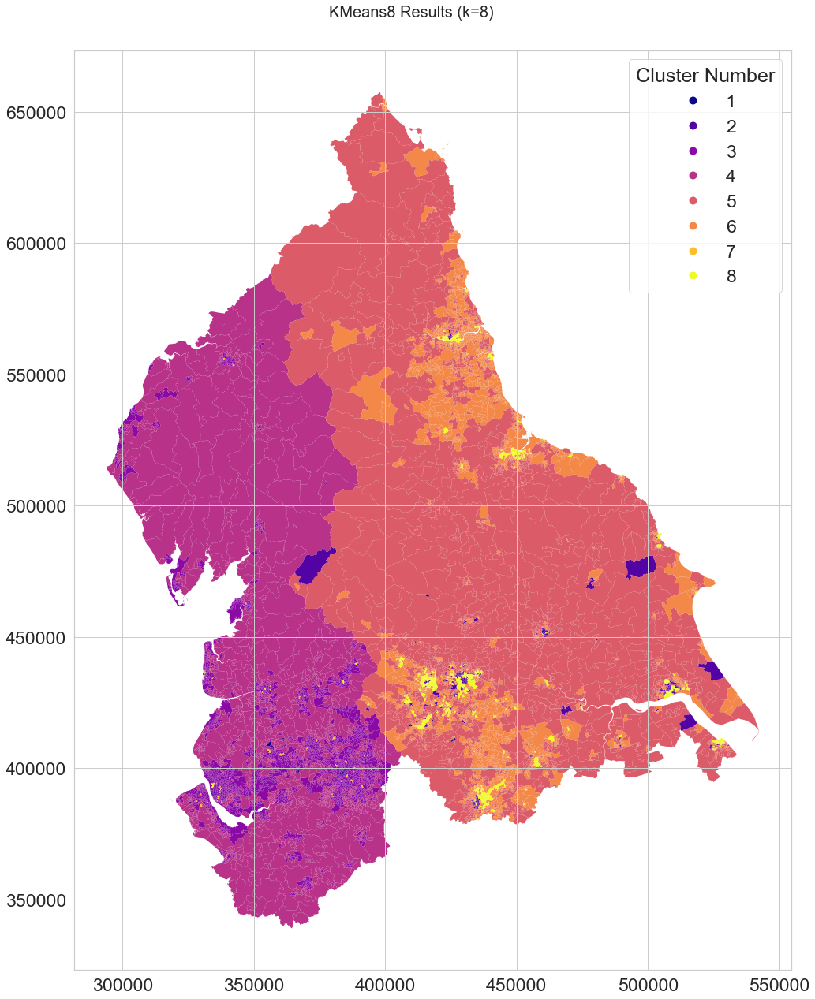

In [147]:
#mapping the clusters
color_map = plt.cm.get_cmap('plasma')
fig, ax = plt.subplots(figsize=(25,20))
fig.suptitle(f"{c_nm8} Results (k={k_pref})", fontsize=20, y=0.92)
results_future_gdf_summary_north.plot(column='K-Means Cluster Number', cmap = color_map, ax=ax, linewidth=0, zorder=0, categorical=True, legend=True);
leg=ax.get_legend()
leg.set(title='Cluster Number')
plt.savefig('ExportedFigures/KMeans8MapNorthFuture.png',bbox_inches='tight')

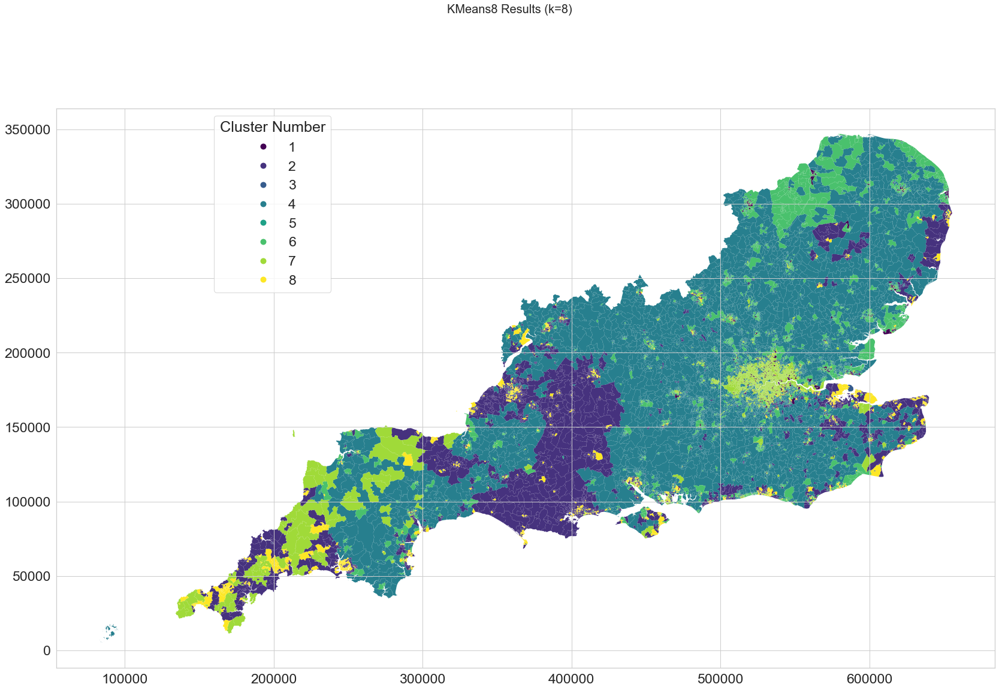

In [148]:
#mapping the clusters
color_map = plt.cm.get_cmap('viridis')
fig, ax = plt.subplots(figsize=(25,20))
fig.suptitle(f"{c_nm8} Results (k={k_pref})", fontsize=20, y=0.92)
results_past_gdf_summary_south.plot(column='K-Means Cluster Number', cmap = color_map, ax=ax, linewidth=0, zorder=0, categorical=True, legend=True);
leg=ax.get_legend()
leg.set(title='Cluster Number')
leg.set_bbox_to_anchor((0.3,1))
plt.savefig('ExportedFigures/KMeans8MapSouthPast.png',bbox_inches='tight')

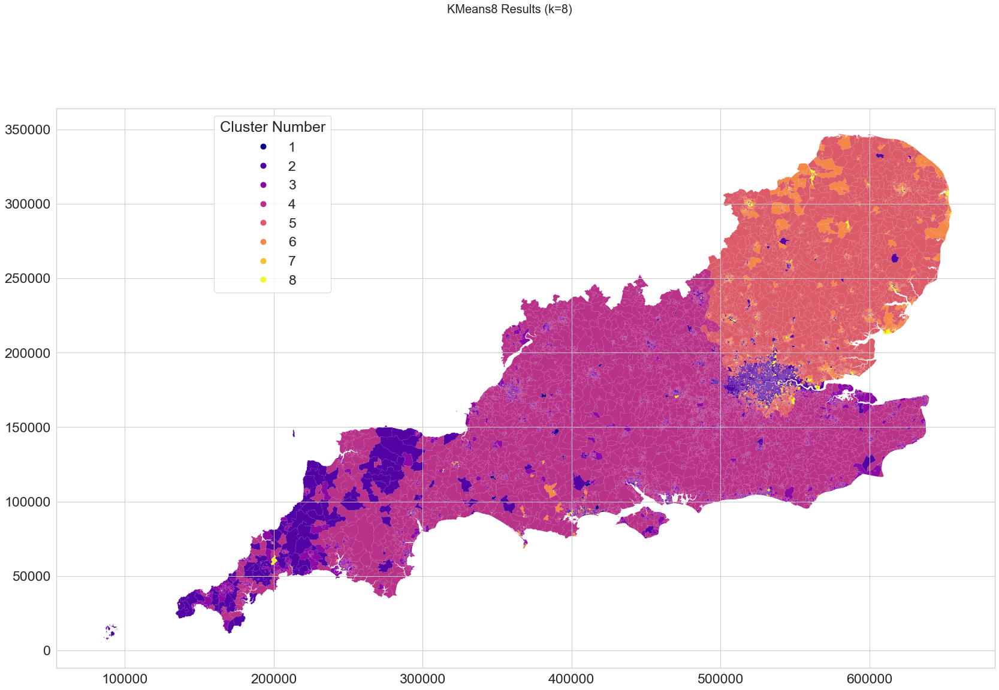

In [149]:
#mapping the clusters
color_map = plt.cm.get_cmap('plasma')
fig, ax = plt.subplots(figsize=(25,20))
fig.suptitle(f"{c_nm8} Results (k={k_pref})", fontsize=20, y=0.92)
results_future_gdf_summary_south.plot(column='K-Means Cluster Number', cmap = color_map, ax=ax, linewidth=0, zorder=0, categorical=True, legend=True);
leg=ax.get_legend()
leg.set(title='Cluster Number')
leg.set_bbox_to_anchor((0.3,1))
plt.savefig('ExportedFigures/KMeans8MapSouthFuture.png',bbox_inches='tight')

# Graphs

In [194]:
list_southernregions = ["North East (England)", "North West (England)", "Yorkshire and The Humber", "West Midlands", "East Midlands", "South West (England)", "East of England", "South East (England)", "London"]
results_past_gdf_summary_england = results_past_gdf_summary[results_past_gdf_summary['NUTS1 Name'].isin(list_southernregions)]

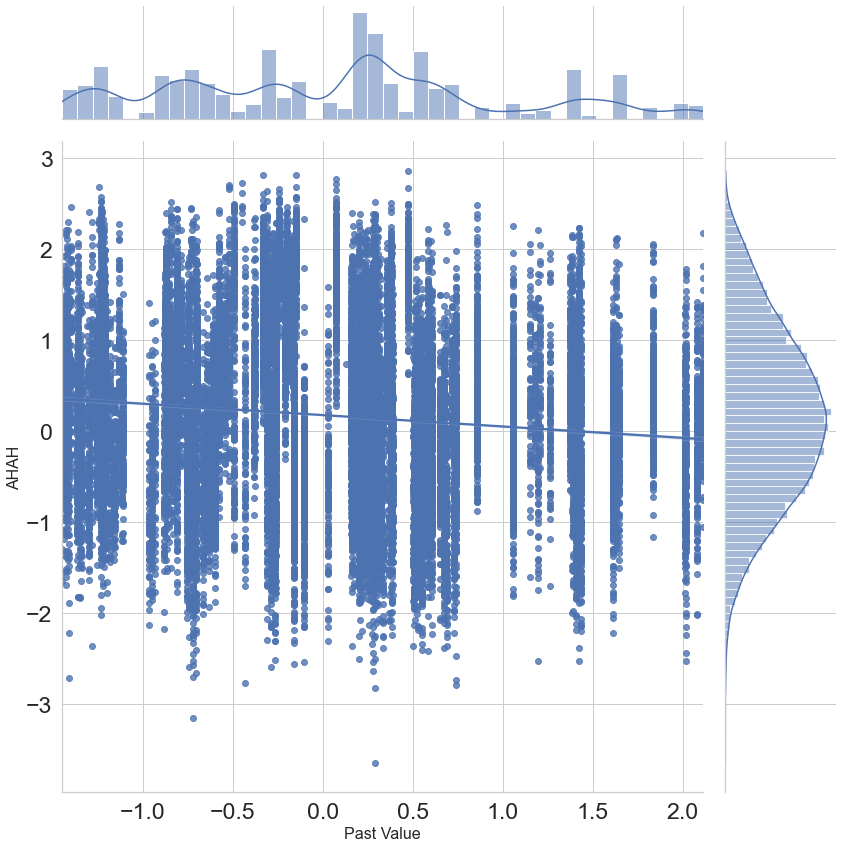

In [197]:
sns.set_style("whitegrid")
#sns.set(font_scale = 1.3)
ax = sns.jointplot(y='AHAH', x = 'Total Past Spending', data=results_past_gdf_summary_england, kind='reg', height=12)
ax.set_axis_labels(ylabel='AHAH', xlabel='Past Value', fontsize=16)
plt.show()

In [196]:
results_past_gdf_summary.columns

Index(['Total Past Spending', 'AHAH', 'GVA', 'Poor Health Indicator',
       'Poor Living Environment Indicator',
       'Poor Access to Amenities Indicator', 'Employment Domain numerator',
       'Income Domain numerator',
       'Proportion of Students not in School Post-16', 'Name', 'Shape_Leng',
       'Shape_Area', 'geometry', 'KMeans6', 'KMeans8',
       'K-Means Cluster Number', 'Cluster Number', 'NUTS3 Name', 'NUTS2 Name',
       'NUTS1 Name'],
      dtype='object')

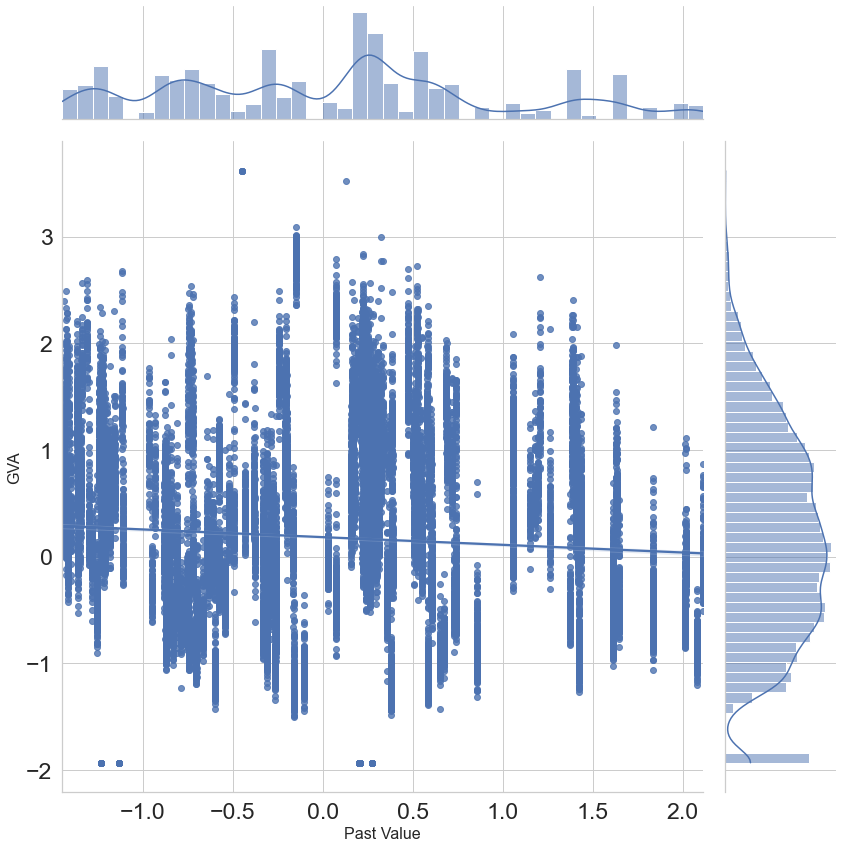

In [202]:
sns.set_style("whitegrid")
#sns.set(font_scale = 1.3)
ax = sns.jointplot(y='GVA', x = 'Total Past Spending', data=results_past_gdf_summary_england, kind='reg', height=12)
ax.set_axis_labels(ylabel='GVA', xlabel='Past Value', fontsize=16)
plt.savefig('ExportedFigures/PastvaluevsGVA.png',bbox_inches='tight')

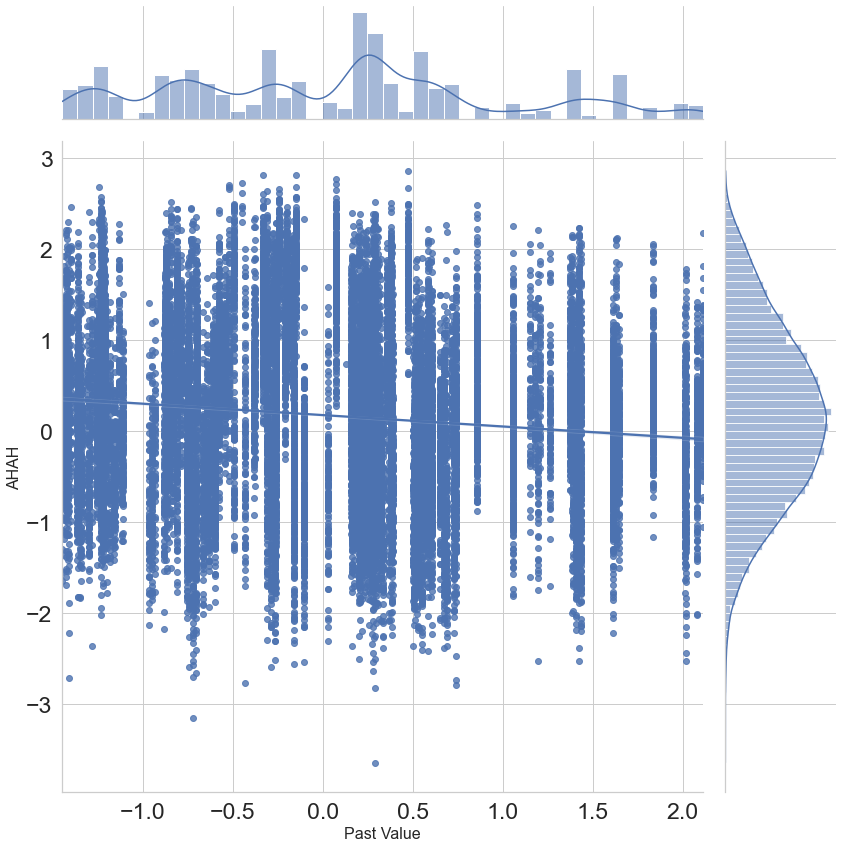

In [200]:
sns.set_style("whitegrid")
#sns.set(font_scale = 1.3)
ax = sns.jointplot(y='AHAH', x = 'Total Past Spending', data=results_past_gdf_summary_england, kind='reg', height=12)
ax.set_axis_labels(ylabel='AHAH', xlabel='Past Value', fontsize=16)
plt.savefig('ExportedFigures/PastvaluevsAHAH.png',bbox_inches='tight')

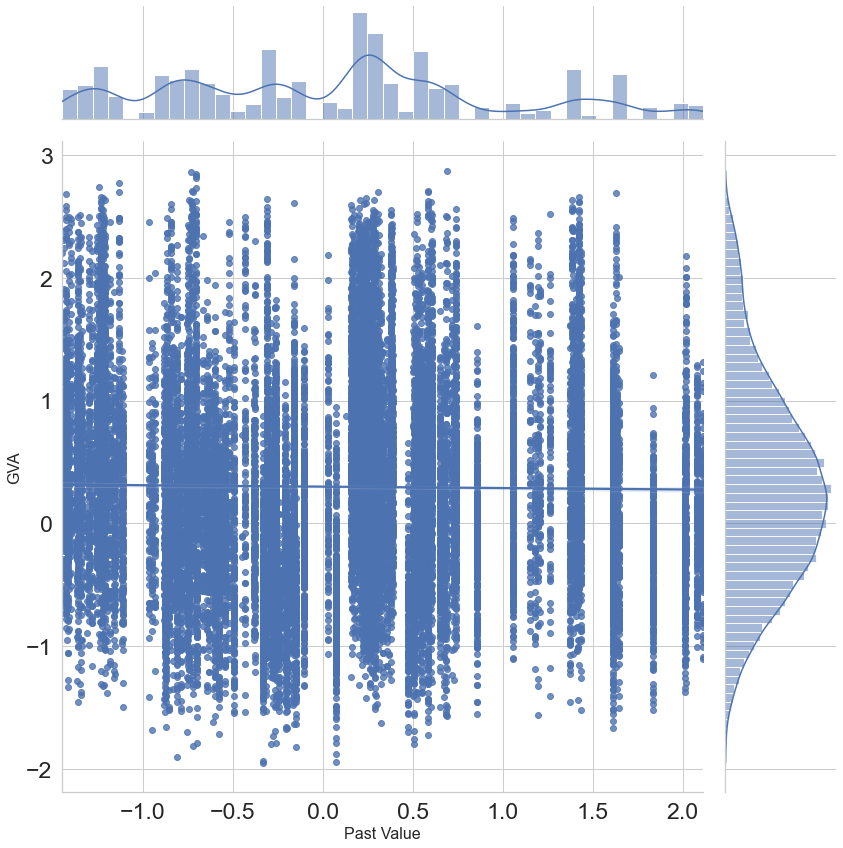

In [203]:
sns.set_style("whitegrid")
#sns.set(font_scale = 1.3)
ax = sns.jointplot(x='Total Past Spending', y = 'Poor Access to Amenities Indicator', data=results_past_gdf_summary_england, kind='reg', height=12)
ax.set_axis_labels(ylabel='GVA', xlabel='Past Value', fontsize=16)
plt.savefig('ExportedFigures/PastvaluevsAccess.png',bbox_inches='tight')

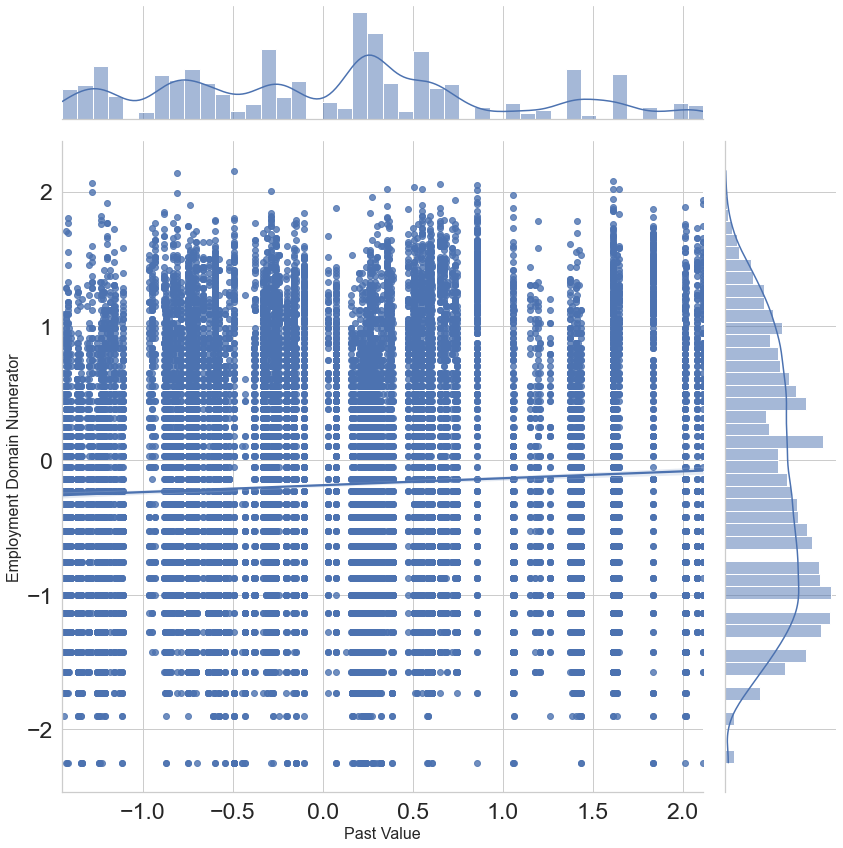

In [205]:
sns.set_style("whitegrid")
#sns.set(font_scale = 1.3)
ax = sns.jointplot(x='Total Past Spending', y = 'Employment Domain numerator', data=results_past_gdf_summary_england, kind='reg', height=12)
ax.set_axis_labels(ylabel='Employment Domain Numerator', xlabel='Past Value', fontsize=16)
plt.savefig('ExportedFigures/PastvaluevsEmployment.png',bbox_inches='tight')

# Priority Area Lookup

In [128]:
# Socioeconomic Indicators
priorityareas = pd.read_csv('ExportedData/Priority-area-lookup.csv', low_memory=False)

In [129]:
results_past_gdf = results_past_gdf.merge(priorityareas, how = 'left', left_on = 'K-Means Cluster Number', right_on = 'Cluster')
results_future_gdf = results_future_gdf.merge(priorityareas,  how = 'left', left_on = 'K-Means Cluster Number', right_on = 'Cluster')

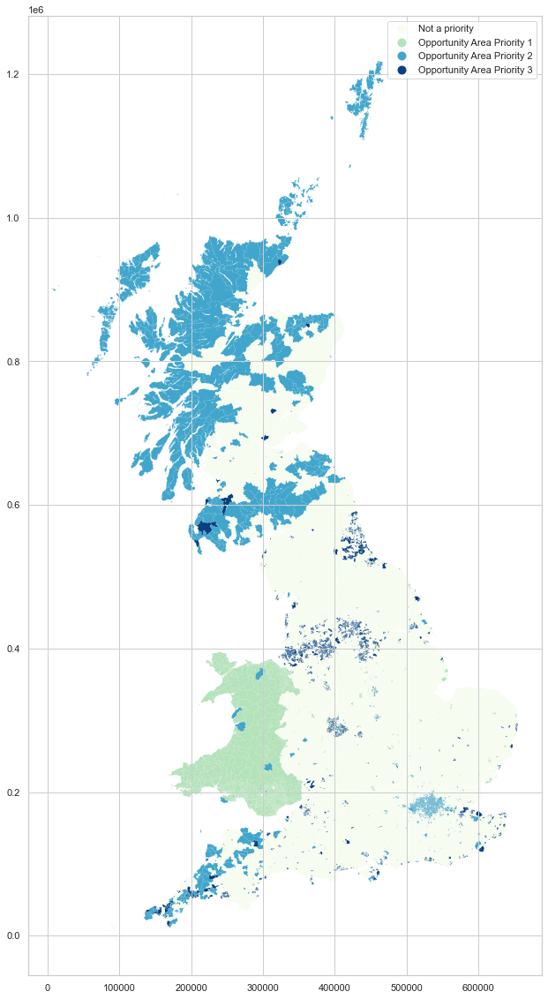

In [130]:
#mapping the clusters
color_map = plt.cm.get_cmap('GnBu')
fig, ax = plt.subplots(figsize=(25,20))
results_past_gdf.plot(column='Scenario 1', cmap = color_map, ax=ax, linewidth=0, zorder=0, categorical=True, legend=True);
#plt.savefig('ExportedFigures/KMeans8MapFuturePriorityAreas.png',bbox_inches='tight')

In [134]:
results_past_gdf_priorityareas = results_past_gdf.merge(lsoas, how = 'left', on = 'geometry')
results_past_gdf_priorityareas.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 41729 entries, 0 to 41728
Data columns (total 24 columns):
 #   Column                                        Non-Null Count  Dtype   
---  ------                                        --------------  -----   
 0   Total Past Spending                           41729 non-null  float64 
 1   AHAH                                          41729 non-null  float64 
 2   GVA                                           41729 non-null  float64 
 3   Poor Health Indicator                         41729 non-null  float64 
 4   Poor Living Environment Indicator             41729 non-null  float64 
 5   Poor Access to Amenities Indicator            41729 non-null  float64 
 6   Employment Domain numerator                   41729 non-null  float64 
 7   Income Domain numerator                       41729 non-null  float64 
 8   Proportion of Students not in School Post-16  41729 non-null  float64 
 9   Name_x                                    

In [136]:
NUTSLookups = NUTSLookups.reset_index()

In [137]:
results_past_gdf_londonpriority =results_past_gdf_priorityareas.merge(NUTSLookups, how = "left", on = "Code")

In [138]:
results_past_gdf_londonpriority = results_past_gdf_londonpriority[results_past_gdf_londonpriority['NUTS1 Name'] == "London"]

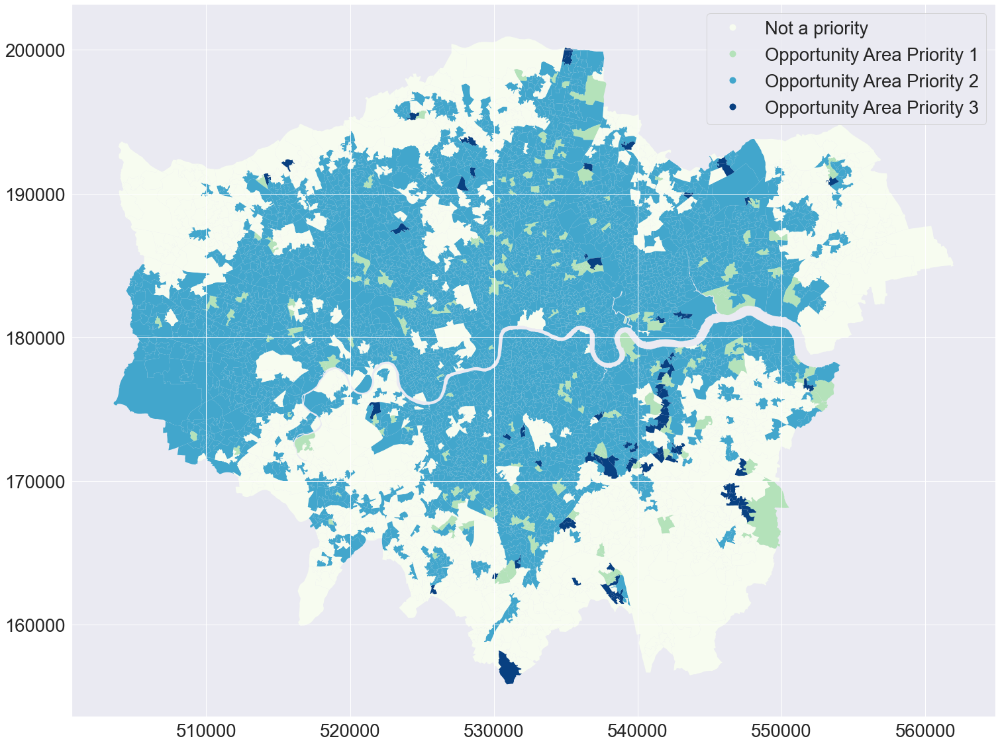

In [144]:
#mapping the clusters
sns.set(font_scale = 2.5)
color_map = plt.cm.get_cmap('GnBu')
fig.suptitle(f"London Priority Areas", fontsize=20, y=0.92)
fig, ax = plt.subplots(figsize=(25,20))
results_past_gdf_londonpriority.plot(column='Scenario 1', cmap = color_map, ax=ax, linewidth=0, zorder=0, categorical=True, legend=True);
plt.savefig('ExportedFigures/KMeans8MapPastLONDONPriorityAreas.png',bbox_inches='tight')

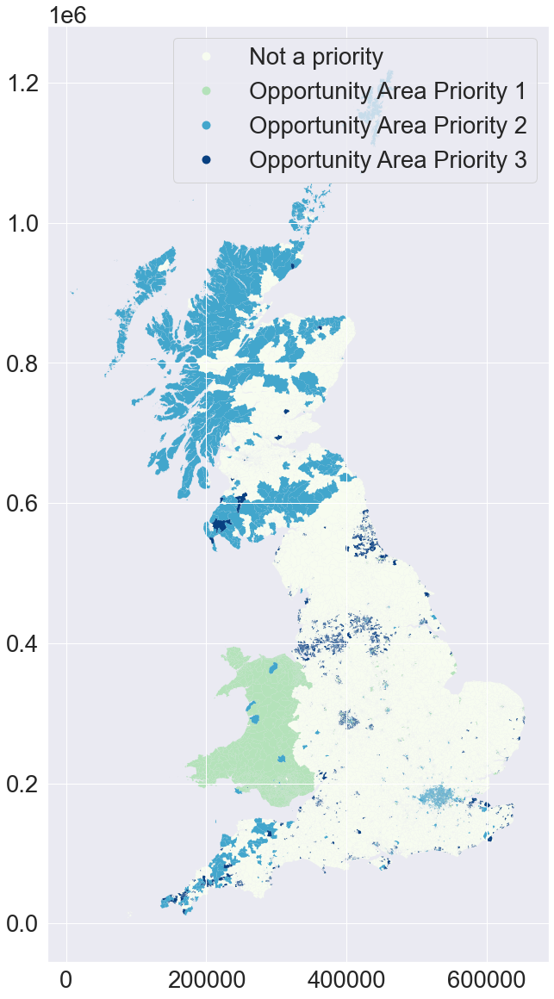

In [145]:
#mapping the clusters
color_map = plt.cm.get_cmap('GnBu')
fig, ax = plt.subplots(figsize=(25,20))
results_past_gdf.plot(column='Scenario 1', cmap = color_map, ax=ax, linewidth=0, zorder=0, categorical=True, legend=True);
plt.savefig('ExportedFigures/KMeans8PastPriorityAreas.png',bbox_inches='tight')

In [149]:
results_past_gdf_priorityareas =results_past_gdf_priorityareas.merge(NUTSLookups, how = "left", on = "Code")

In [151]:
results_past_gdf_priorityareas.columns

Index(['Total Past Spending', 'AHAH', 'GVA', 'Poor Health Indicator',
       'Poor Living Environment Indicator',
       'Poor Access to Amenities Indicator', 'Employment Domain numerator',
       'Income Domain numerator',
       'Proportion of Students not in School Post-16', 'Name_x',
       'Shape_Leng_x', 'Shape_Area_x', 'geometry', 'KMeans6', 'KMeans9',
       'KMeans8', 'K-Means Cluster Number', 'Cluster', 'Scenario 1',
       'Scenario 2', 'Code', 'Name_y', 'Shape_Leng_y', 'Shape_Area_y',
       'NUTS3 Name', 'NUTS2 Name', 'NUTS1 Name'],
      dtype='object')

In [154]:
results_past_gdf_priorityareas_graph = results_past_gdf_priorityareas[['NUTS1 Name', 'Scenario 1', 'K-Means Cluster Number', 'Code']]
results_past_gdf_priorityareas_graph

,NUTS1 Name,Scenario 1,K-Means Cluster Number,Code
0,London,Not a priority,4,E01000001
1,London,Opportunity Area Priority 2,7,E01000002
2,London,Opportunity Area Priority 2,7,E01000003
3,London,Opportunity Area Priority 2,7,E01000005
4,London,Opportunity Area Priority 2,7,E01000006
...,...,...,...,...
41724,Scotland,Not a priority,3,S01013477
41725,Scotland,Not a priority,3,S01013478
41726,Scotland,Not a priority,3,S01013479
41727,Scotland,Not a priority,3,S01013480


In [162]:
results_past_gdf_priorityareas_graph = results_past_gdf_priorityareas[['NUTS1 Name', 'Scenario 1', 'K-Means Cluster Number', 'Code']]
results_past_gdf_priorityareas_graph1 = results_past_gdf_priorityareas_graph.pivot_table(index='NUTS1 Name',columns='Scenario 1', values = 'Code', aggfunc='count')
results_past_gdf_priorityareas_graph1 = results_past_gdf_priorityareas_graph1.reset_index()

results_past_gdf_priorityareas_graph1

Scenario 1,Not a priority,Opportunity Area Priority 1,Opportunity Area Priority 2,Opportunity Area Priority 3
NUTS1 Name,,,,
East Midlands (England),2333,278,99,64
East of England,3193,199,147,75
London,1091,219,3454,71
North East (England),970,69,8,610
North West (England),2304,23,71,2099
Scotland,6533,4,389,50
South East (England),4227,35,465,655
South West (England),2304,9,143,825
Wales,8,1889,11,1


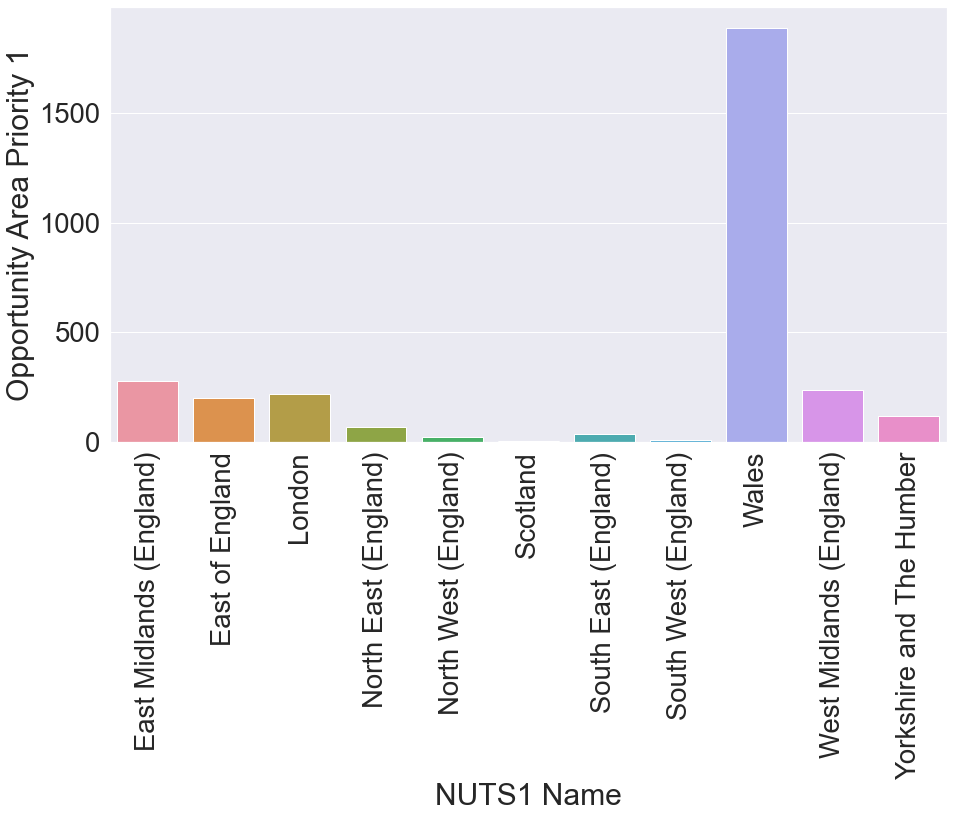

In [172]:
plt.figure(figsize=(15,8))

ax = sns.barplot(x='NUTS1 Name', y="Opportunity Area Priority 1", data=results_past_gdf_priorityareas_graph1)
plt.xticks(rotation=90)
plt.show()

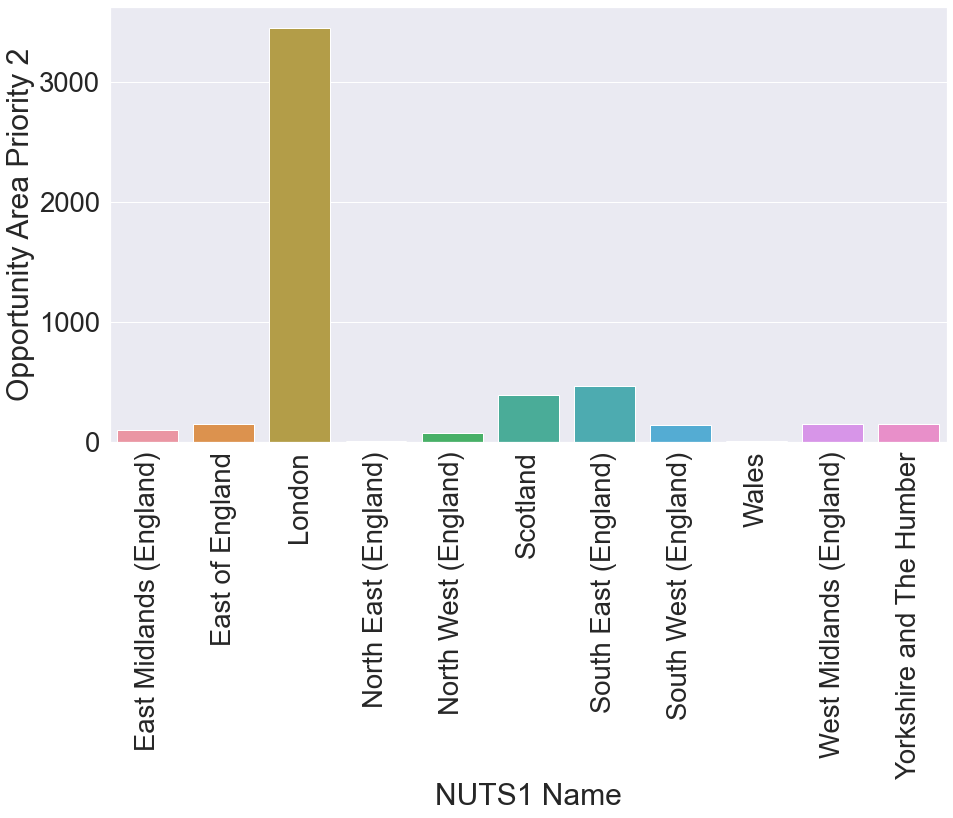

In [173]:
plt.figure(figsize=(15,8))

ax = sns.barplot(x='NUTS1 Name', y="Opportunity Area Priority 2", data=results_past_gdf_priorityareas_graph1)
plt.xticks(rotation=90)
plt.show()

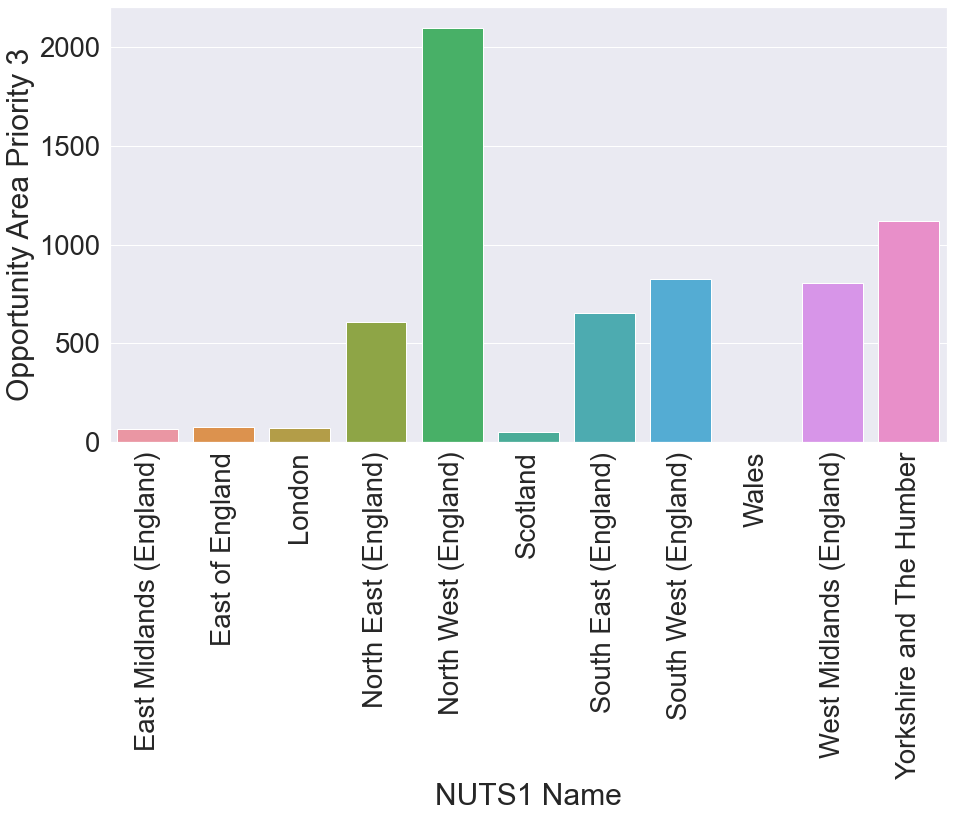

In [174]:
plt.figure(figsize=(15,8))

ax = sns.barplot(x='NUTS1 Name', y="Opportunity Area Priority 3", data=results_past_gdf_priorityareas_graph1)
plt.xticks(rotation=90)
plt.show()

In [180]:
#melt dataframe
results_past_gdf_priorityareas_graph2 = results_past_gdf_priorityareas_graph1.melt(id_vars = ['NUTS1 Name'], value_vars=['Opportunity Area Priority 1', 'Opportunity Area Priority 2', 'Opportunity Area Priority 3'])
results_past_gdf_priorityareas_graph2.rename(columns={'value':'Count of SAZs'}, inplace = True)
results_past_gdf_priorityareas_graph2

,NUTS1 Name,Scenario 1,value
0,East Midlands (England),Opportunity Area Priority 1,278
1,East of England,Opportunity Area Priority 1,199
2,London,Opportunity Area Priority 1,219
3,North East (England),Opportunity Area Priority 1,69
4,North West (England),Opportunity Area Priority 1,23
5,Scotland,Opportunity Area Priority 1,4
6,South East (England),Opportunity Area Priority 1,35
7,South West (England),Opportunity Area Priority 1,9
8,Wales,Opportunity Area Priority 1,1889
9,West Midlands (England),Opportunity Area Priority 1,238


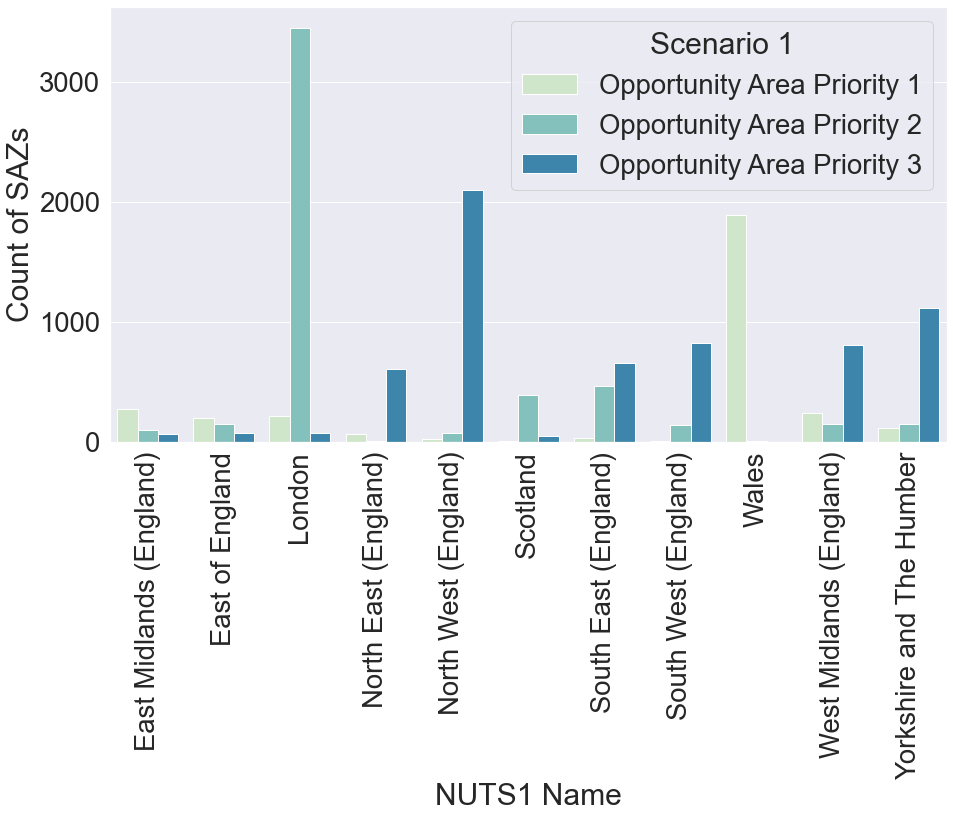

In [186]:
plt.figure(figsize=(15,8))

ax = sns.barplot(x='NUTS1 Name', y='Count of SAZs', hue="Scenario 1", data=results_past_gdf_priorityareas_graph2, palette="GnBu")
plt.xticks(rotation=90)
plt.savefig('ExportedFigures/PriorityAreaDistribution.png',bbox_inches='tight')